# 3D Scalar Advection Solver on a Sphere Using Radial Basis Functions

Samm Elliott

### The PDE
The transport equation for a passive tracer with mixing ratio $q$, without sources or sinks, can be written in the conservative flux form given by

$$\frac{\partial(\rho q)}{\partial t} + \nabla\cdot(\rho q \bar{u}) = 0.$$
$$\frac{\partial{q}}{\partial t} = - \bar{u}\cdot\nabla{q} .$$

where $\rho$ is the air density, $\bar{u}$ is the wind field and $\nabla$ is the standard 3D gradient operator. The mass continuity equation is given by

$$\frac{\partial\rho}{\partial t} + \nabla\cdot(\rho \bar{u}) = 0.$$

### Import Libraries

In [1]:
import numpy as np
from numpy import linalg as nla
import matplotlib.pyplot as plt
%matplotlib inline
from mpl_toolkits.mplot3d.axes3d import Axes3D
import scipy.sparse as ssparse
from scipy.sparse import linalg as sla
import time

# Physical Constants

In [2]:
a = 6.37122*(10**6)  # radius of the Earth (m)
g = 9.80616          # gravitational constant (m s^(-2))
p0 = 100000.0        # reference surface pressure (Pa)
cp = 1004.5          # specific heat capacity of dry air (J kg^(-1) K^(-1))
Rd = 287.0           # gas constant for dry air (J kg^(-1) K^(-1))
kappa = Rd/cp        # ratio of Rd to cp
T0 = 300.0           # isothermal atmosphere temperature (K)
pi = np.pi           # pi

### Simulation Parameterizations

In [3]:
htop = 12000.0       # height position of model top (m)
# Nh = 27556            # number of horizontal nodes
Nh = 10000            # number of horizontal nodes
Nv = 30              # number of vertical nodes
n = 55               # RBF stencil size

### Initializing the Nodeset

We first read in the specified maximal determinant (MD) nodes and add vertical levels for our nodeset. These MD nodes were aquired from http://web.maths.unsw.edu.au/~rsw/Sphere/. Check ./md directory for available nodesets.

In [4]:
# read in MD nodes - note these are for a unit sphere
X_hat = np.loadtxt("nodesets/md."+str(Nh).zfill(5),usecols = (0,1,2)).T

If $\hat{x}$ is a MD nodepoint on a unit sphere, then the corresponding point $\bar{x}$ in our domain for vertical level $n$ is given by

$$\bar{x} = (a+n\frac{z_{top}}{N_v})\hat{x}$$

In [5]:
# create nodeset
h = htop/Nv
rlvls = a + np.linspace(-2*h, htop + 3*h, num = Nv + 6)
X = np.tensordot(X_hat, rlvls, 0)

The following plots the MD nodes and the nodeset for our domain.

In [6]:
# fig = plt.figure(figsize=(8,8))
# ax = fig.add_subplot(1, 1, 1, projection='3d')
# ax.scatter(md_nodes[0],md_nodes[1],md_nodes[2])

In [7]:
# fig = plt.figure(figsize=(20,20))
# ax = fig.add_subplot(1, 1, 1, projection='3d')
# ax.scatter(xx[0],xx[1],xx[2])

### Creating n-point Stencils

We can just use the MD nodeset since the stencils will be valid for any radially scaled version of the nodeset. 

In [8]:
%run RBFFD_Generation.ipynb
%time DMs,FDVs,idx = get_RBFFD_DMs(X_hat,n)
depth = 3

get_RBFFD_DMs status: node_id = 0
get_RBFFD_DMs status: node_id = 1000
get_RBFFD_DMs status: node_id = 2000
get_RBFFD_DMs status: node_id = 3000
get_RBFFD_DMs status: node_id = 4000
get_RBFFD_DMs status: node_id = 5000
get_RBFFD_DMs status: node_id = 6000
get_RBFFD_DMs status: node_id = 7000
get_RBFFD_DMs status: node_id = 8000
get_RBFFD_DMs status: node_id = 9000
CPU times: user 4min, sys: 38.1 s, total: 4min 38s
Wall time: 1min 24s


In [9]:
# fig = plt.figure(figsize=(12,12))
# ax = fig.add_subplot(1, 1, 1, projection='3d')
# ax.scatter(X_hat[0],X_hat[1],X_hat[2],marker='o',c='blue',s=10)
# ax.scatter(X_hat[0,idx[0]],X_hat[1,idx[0]],X_hat[2,idx[0]],marker='o',c='green',s=50)
# ax.view_init(60,30)


## Test Case 1: Three Dimensional Deformational Flow

In [10]:
# tau = 1036800.0               # test case duration (s)
# b = .2                      # normalized pressure depth of the divergent layer
# omega0 = 23000.0 * pi / tau  # Maximum of the vertical pressure velocity in units of Pa s^(-1)
# R_t = a/2
# Z_t = 1000

%run TC1_3D_deformational_flow.ipynb
r,lmbda,phi = c2s(X[0],X[1],X[2])

In [11]:
# pltlvl = 24
# fig = plt.figure(figsize=(20,20))
# ax = fig.add_subplot(3,2,1)
# cax = ax.scatter(lmbda[:,0],phi[:,0],c = u_lmbda_t(r,lmbda,phi,0,1,0)[:,pltlvl])
# cbar = fig.colorbar(cax)
# ax = fig.add_subplot(3,2,2)
# cax = ax.scatter(lmbda[:,0],phi[:,0],c = u_lmbda_t(r,lmbda,phi,0,0,1)[:,pltlvl])
# cbar = fig.colorbar(cax)
# ax = fig.add_subplot(3,2,3)
# cax = ax.scatter(lmbda[:,0],phi[:,0],c = u_phi_t(r,lmbda,phi,0)[:,pltlvl])
# cbar = fig.colorbar(cax)
# ax = fig.add_subplot(3,2,4)
# cax = ax.scatter(lmbda[:,0],phi[:,0],c = u_r_t(r,lmbda,phi,0)[:,pltlvl])
# cbar = fig.colorbar(cax)
# ax = fig.add_subplot(3,2,5)
# cax = ax.scatter(lmbda[:,0],phi[:,0],c = q1(r,lmbda,phi)[:,pltlvl])
# cbar = fig.colorbar(cax)
# print(np.max(p(r)[:,depth:Nv+depth]),p(a+htop),p0)

## Timestepping

In [12]:
def set_ghosts(var):
    
    for i in range(1,depth):
        
        var[:,depth - i] = 0.0
        var[:,(Nv + depth - 1) + i] = 0.0
    
    return var

In [13]:
def eval_rbffd_diff(var,FDV,DM,idx):
    
    F = np.empty((Nh,Nv))
    
    for i in range(Nh):
        
        var_i = var[idx[i]]
        
        for j in range(Nv):
            
            F[i,j] = np.vdot(var_i[:,j+3],DM[i])/rlvls[j+3] + np.vdot(var_i[0,j:j+7],FDV[i])/h
    
    return F

def eval_RHS(q_t,U,FDVs,DMs,idx):
    
    dq_dx = eval_rbffd_diff(q_t,FDVs[:,0],DMs[:,0],idx)
    dq_dy = eval_rbffd_diff(q_t,FDVs[:,1],DMs[:,1],idx)
    dq_dz = eval_rbffd_diff(q_t,FDVs[:,2],DMs[:,2],idx)
    
    RHS = - ((U[0]*dq_dx) + (U[1]*dq_dy) + (U[2]*dq_dz))
    
    return RHS
    

In [14]:
# # ### Test 1
# # z = (r-a)
# # ff = (z/htop)**2
# # ff_x1 = ((2*X[0]*z)/(r*(htop**2)))[:,depth:Nv+depth]
# # ff_y1 = ((2*X[1]*z)/(r*(htop**2)))[:,depth:Nv+depth]
# # ff_z1 = ((2*X[2]*z)/(r*(htop**2)))[:,depth:Nv+depth]

# ### Test 2
# ff = np.sin(X[0]/a + pi/4) * np.sin(X[1]/a + pi/4) * np.sin(X[2]/a + pi/4) * a
# ff_x1 = ((np.cos(X[0]/a + pi/4) * np.sin(X[1]/a + pi/4) * np.sin(X[2]/a + pi/4)))[:,depth:Nv+depth]
# ff_y1 = ((np.sin(X[0]/a + pi/4) * np.cos(X[1]/a + pi/4) * np.sin(X[2]/a + pi/4)))[:,depth:Nv+depth]
# ff_z1 = ((np.sin(X[0]/a + pi/4) * np.sin(X[1]/a + pi/4) * np.cos(X[2]/a + pi/4)))[:,depth:Nv+depth]


# ### Evaluate Diffs
# print("Testing DMs:",DMs[:,0].shape)
# ff_x2 = eval_rbffd_diff(ff,FDVs[:,0],DMs[:,0],idx)
# ff_y2 = eval_rbffd_diff(ff,FDVs[:,1],DMs[:,1],idx)
# ff_z2 = eval_rbffd_diff(ff,FDVs[:,2],DMs[:,2],idx)
# print("\tf:","\n\t\tmin = {0:e}".format(np.min(ff)),"\n\t\tmax = {0:e}".format(np.max(ff)))
# print("\tf_x:","\n\t\tmax(f_x) = {0:e}".format(np.max(np.abs(ff_x1))),"\n\t\tmax_err(f_x) = {0:e}".format(np.max(np.abs(ff_x1-ff_x2))),"\n\t\tmedian_err(f_x) = {0:e}".format(np.median(np.abs(ff_x1-ff_x2))),"\n\t\tave_err(f_x) = {0:e}".format(np.mean(np.abs(ff_x1-ff_x2))))
# print("\tf_y:","\n\t\tmax(f_y) = {0:e}".format(np.max(np.abs(ff_y1))),"\n\t\tmax_err(f_y) = {0:e}".format(np.max(np.abs(ff_y1-ff_y2))),"\n\t\tmedian_err(f_y) = {0:e}".format(np.median(np.abs(ff_y1-ff_y2))),"\n\t\tave_err(f_y) = {0:e}".format(np.mean(np.abs(ff_y1-ff_y2))))
# print("\tf_z:","\n\t\tmax(f_z) = {0:e}".format(np.max(np.abs(ff_z1))),"\n\t\tmax_err(f_z) = {0:e}".format(np.max(np.abs(ff_z1-ff_z2))),"\n\t\tmedian_err(f_z) = {0:e}".format(np.median(np.abs(ff_z1-ff_z2))),"\n\t\tave_err(f_z) = {0:e}".format(np.mean(np.abs(ff_z1-ff_z2))))


Finished time step 0 of 576 total -> 2.08e+01 seconds/timestep


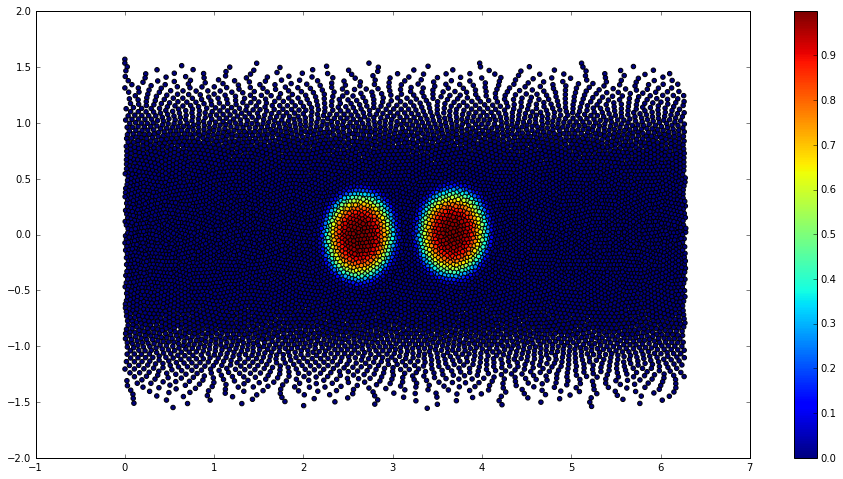

Finished time step 1 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 2 of 576 total -> 2.03e+01 seconds/timestep
Finished time step 3 of 576 total -> 2.18e+01 seconds/timestep
Finished time step 4 of 576 total -> 2.08e+01 seconds/timestep
Finished time step 5 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 6 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 7 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 8 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 9 of 576 total -> 1.96e+01 seconds/timestep


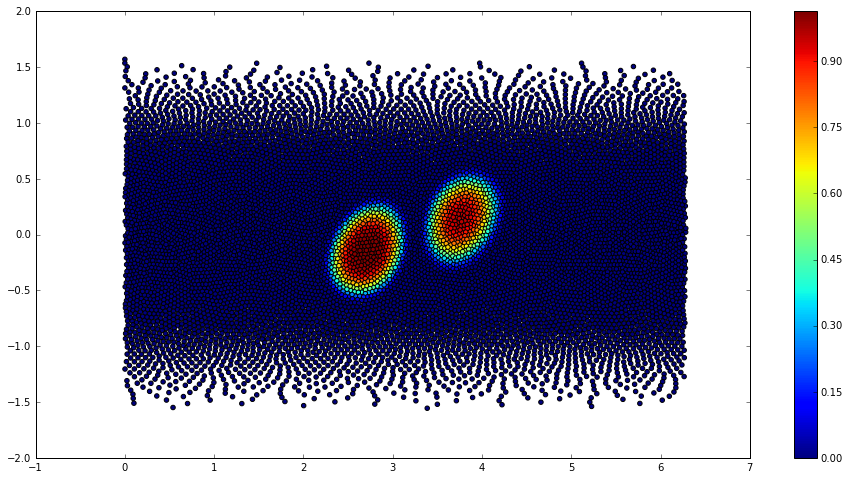

Finished time step 10 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 11 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 12 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 13 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 14 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 15 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 16 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 17 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 18 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 19 of 576 total -> 2.03e+01 seconds/timestep


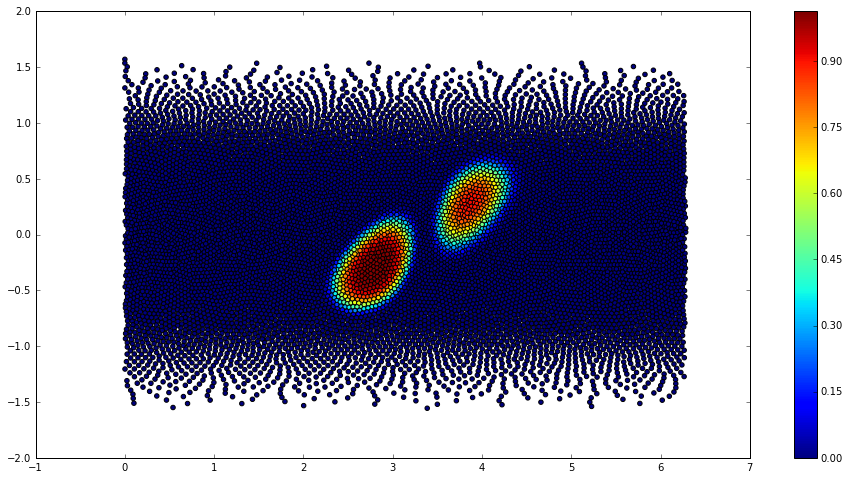

Finished time step 20 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 21 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 22 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 23 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 24 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 25 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 26 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 27 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 28 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 29 of 576 total -> 1.94e+01 seconds/timestep


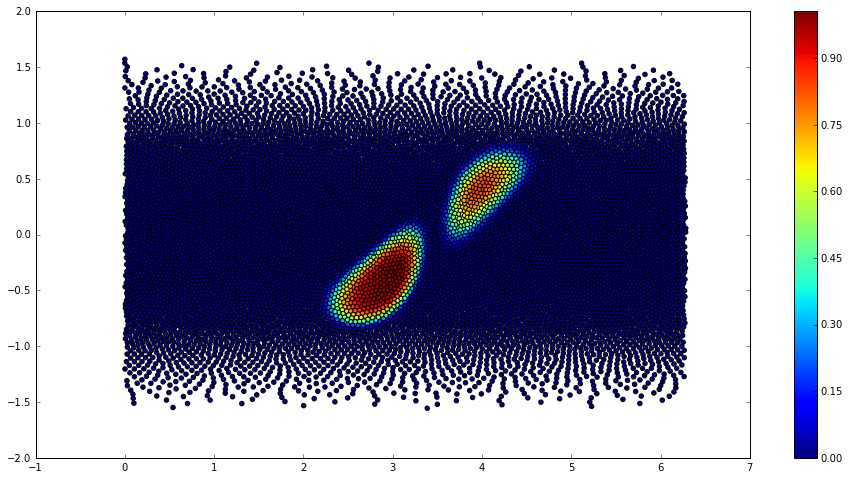

Finished time step 30 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 31 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 32 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 33 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 34 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 35 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 36 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 37 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 38 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 39 of 576 total -> 1.97e+01 seconds/timestep


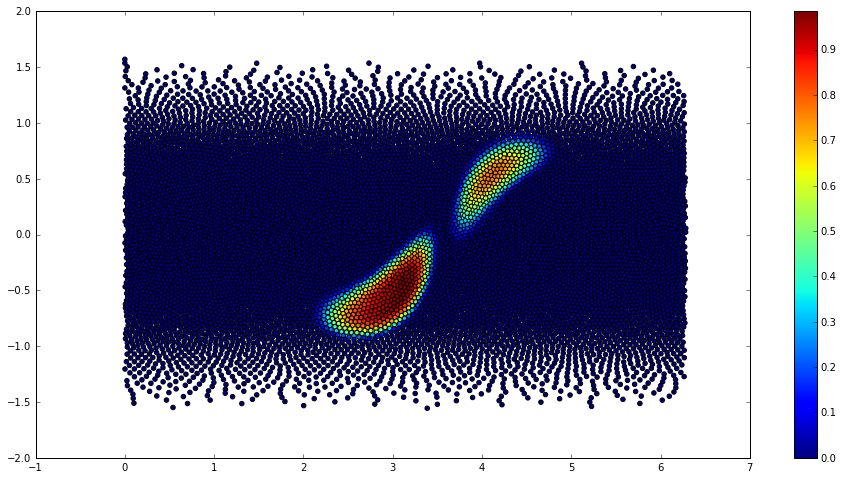

Finished time step 40 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 41 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 42 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 43 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 44 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 45 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 46 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 47 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 48 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 49 of 576 total -> 1.97e+01 seconds/timestep


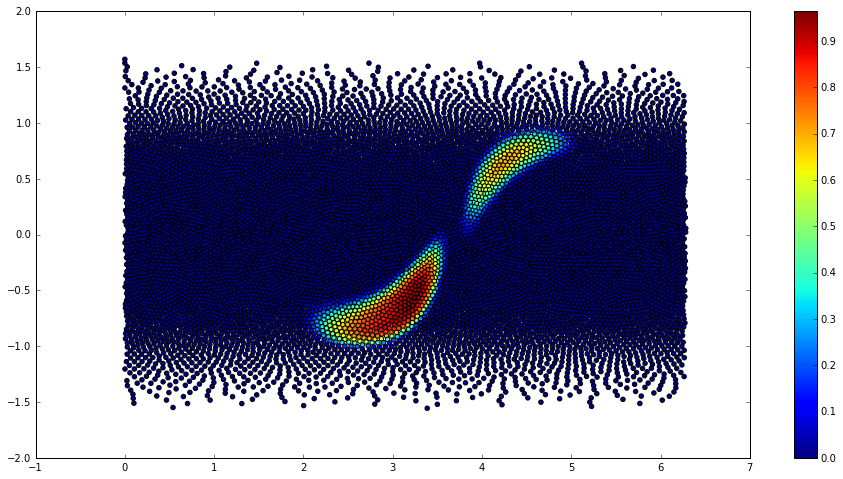

Finished time step 50 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 51 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 52 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 53 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 54 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 55 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 56 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 57 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 58 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 59 of 576 total -> 1.96e+01 seconds/timestep


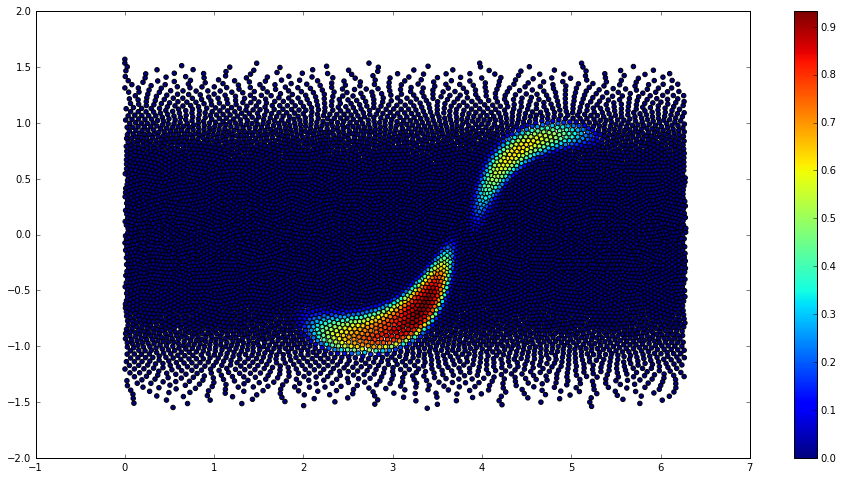

Finished time step 60 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 61 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 62 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 63 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 64 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 65 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 66 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 67 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 68 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 69 of 576 total -> 1.96e+01 seconds/timestep


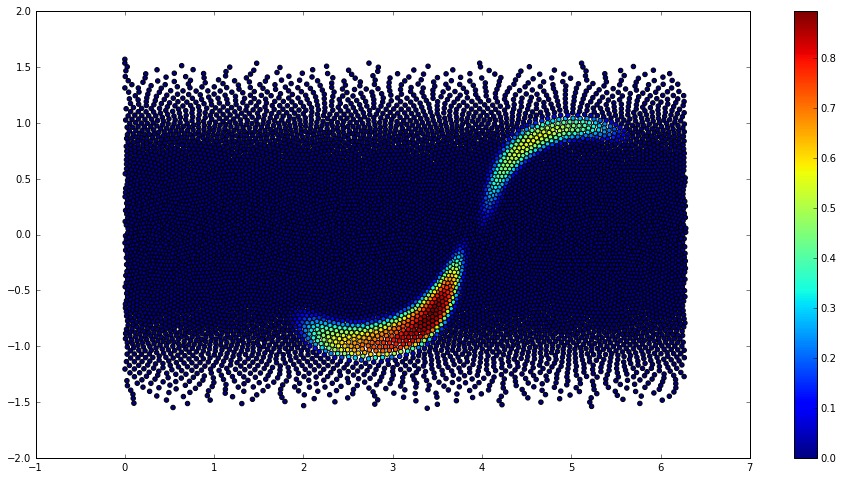

Finished time step 70 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 71 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 72 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 73 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 74 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 75 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 76 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 77 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 78 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 79 of 576 total -> 1.97e+01 seconds/timestep


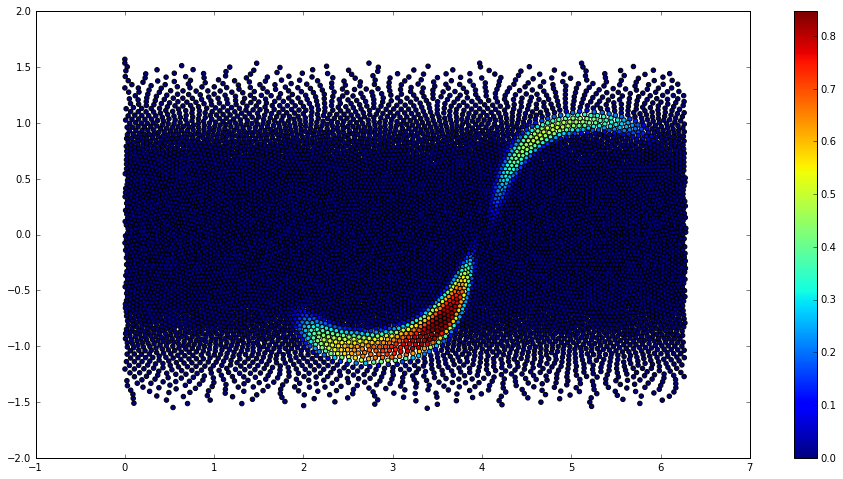

Finished time step 80 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 81 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 82 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 83 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 84 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 85 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 86 of 576 total -> 2.08e+01 seconds/timestep
Finished time step 87 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 88 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 89 of 576 total -> 1.96e+01 seconds/timestep


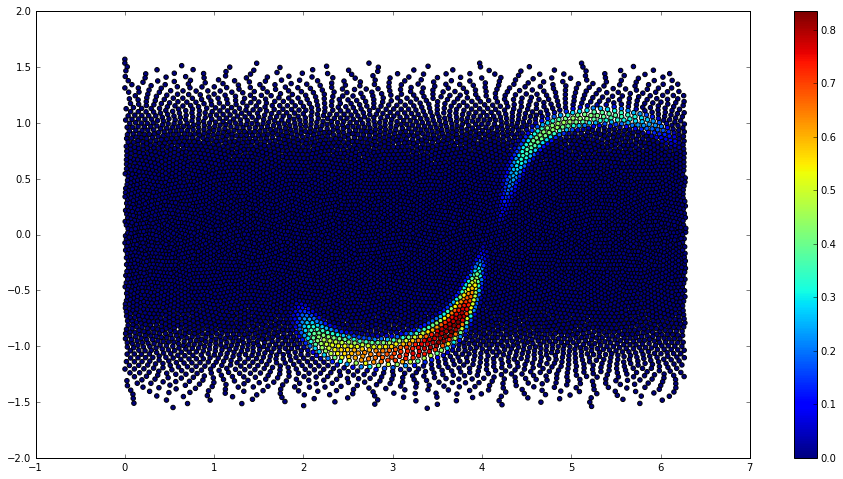

Finished time step 90 of 576 total -> 2.05e+01 seconds/timestep
Finished time step 91 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 92 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 93 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 94 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 95 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 96 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 97 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 98 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 99 of 576 total -> 1.96e+01 seconds/timestep


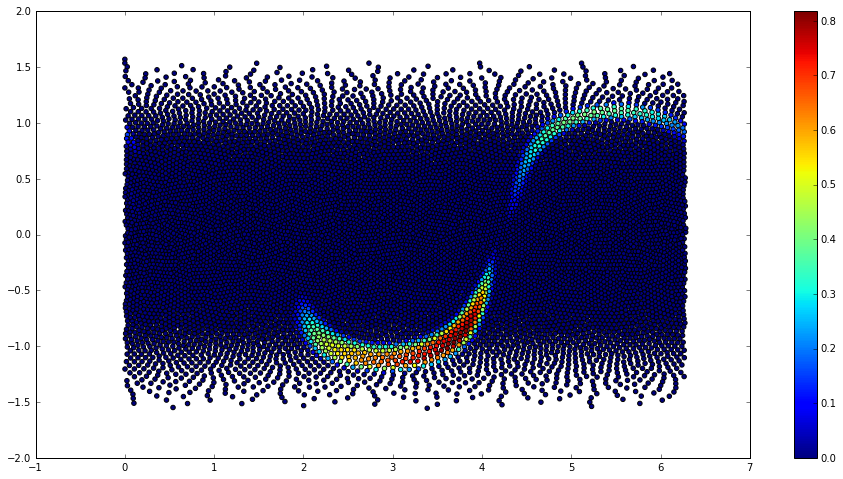

Finished time step 100 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 101 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 102 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 103 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 104 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 105 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 106 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 107 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 108 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 109 of 576 total -> 1.97e+01 seconds/timestep


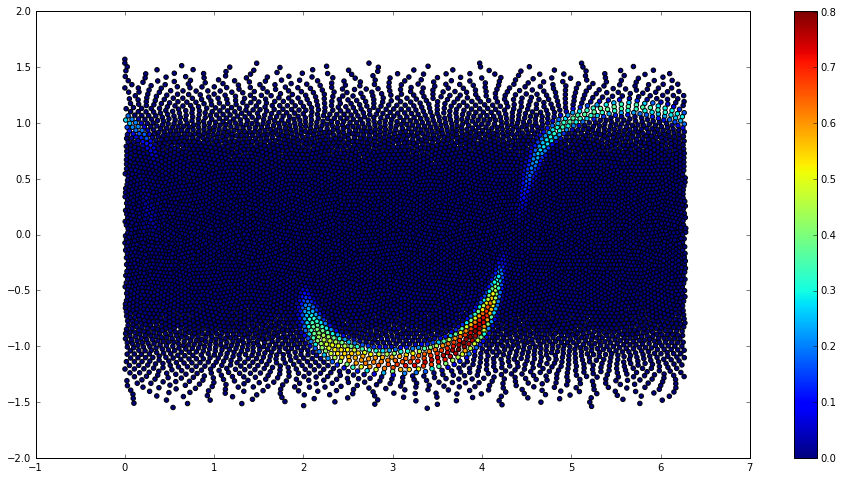

Finished time step 110 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 111 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 112 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 113 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 114 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 115 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 116 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 117 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 118 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 119 of 576 total -> 1.97e+01 seconds/timestep


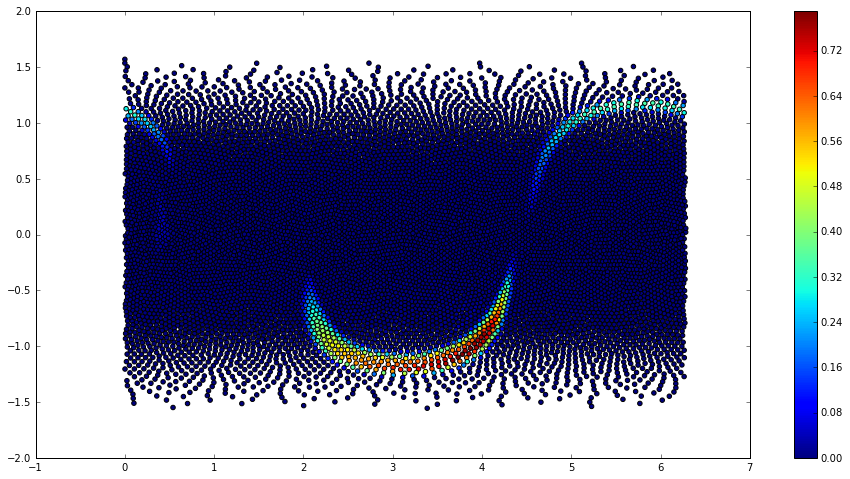

Finished time step 120 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 121 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 122 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 123 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 124 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 125 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 126 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 127 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 128 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 129 of 576 total -> 1.96e+01 seconds/timestep


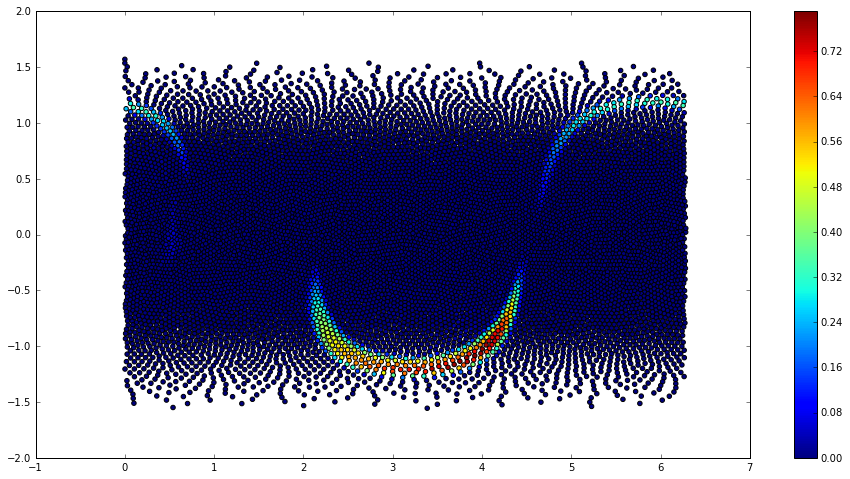

Finished time step 130 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 131 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 132 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 133 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 134 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 135 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 136 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 137 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 138 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 139 of 576 total -> 1.95e+01 seconds/timestep


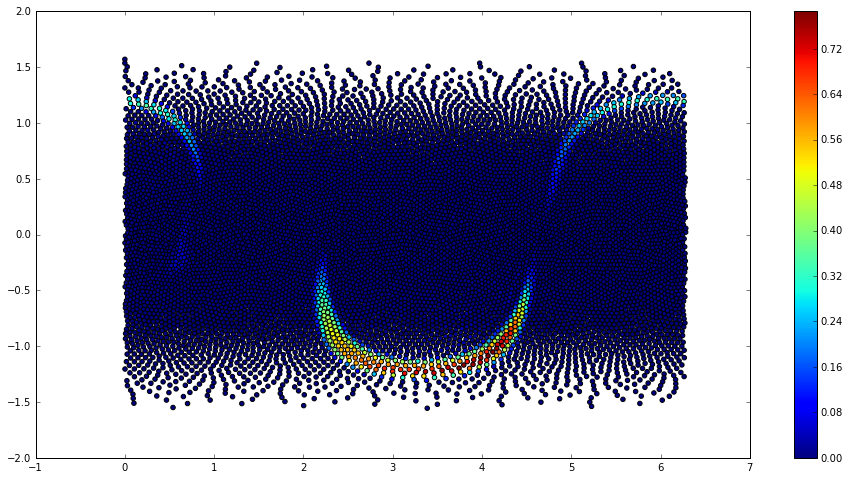

Finished time step 140 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 141 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 142 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 143 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 144 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 145 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 146 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 147 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 148 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 149 of 576 total -> 1.96e+01 seconds/timestep


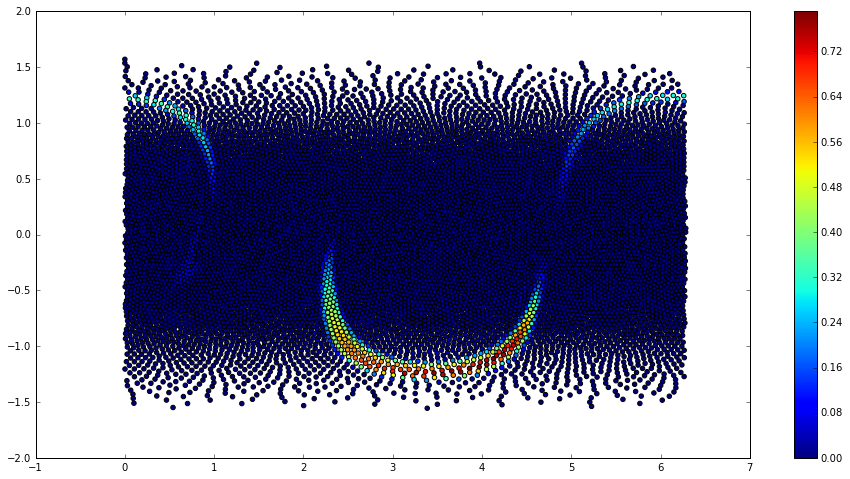

Finished time step 150 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 151 of 576 total -> 1.88e+01 seconds/timestep
Finished time step 152 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 153 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 154 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 155 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 156 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 157 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 158 of 576 total -> 1.94e+01 seconds/timestep
Finished time step 159 of 576 total -> 1.96e+01 seconds/timestep


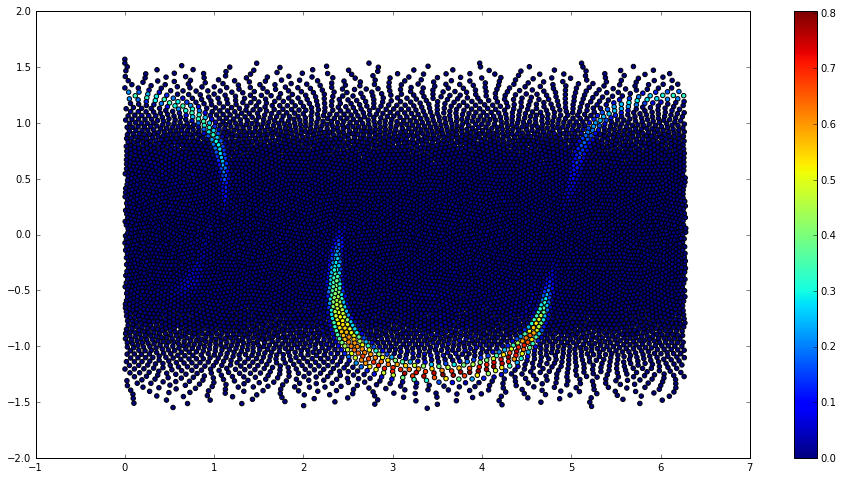

Finished time step 160 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 161 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 162 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 163 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 164 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 165 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 166 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 167 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 168 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 169 of 576 total -> 1.96e+01 seconds/timestep


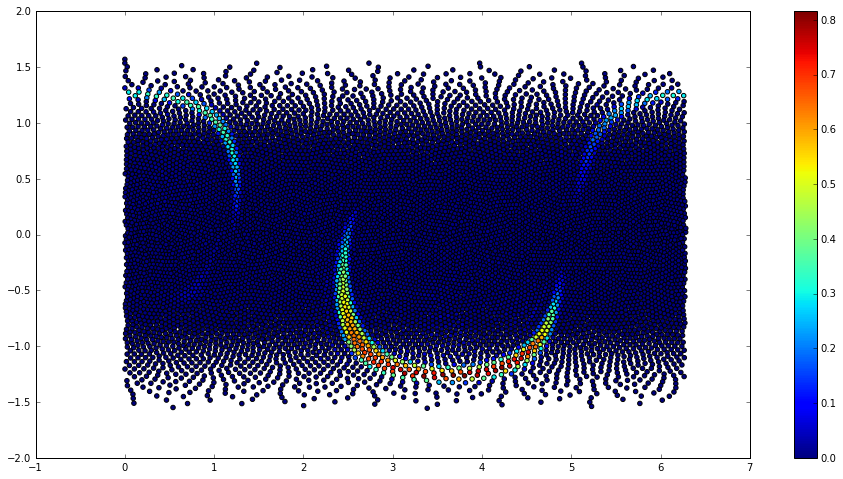

Finished time step 170 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 171 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 172 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 173 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 174 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 175 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 176 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 177 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 178 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 179 of 576 total -> 1.96e+01 seconds/timestep


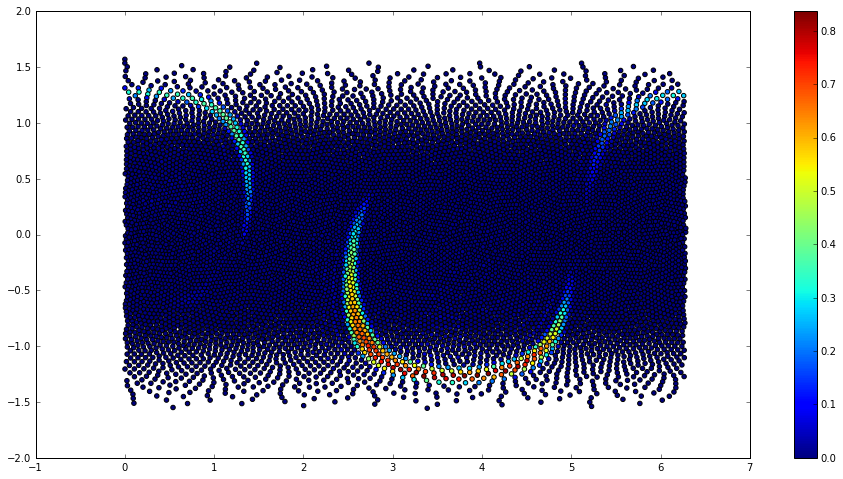

Finished time step 180 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 181 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 182 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 183 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 184 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 185 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 186 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 187 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 188 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 189 of 576 total -> 1.96e+01 seconds/timestep


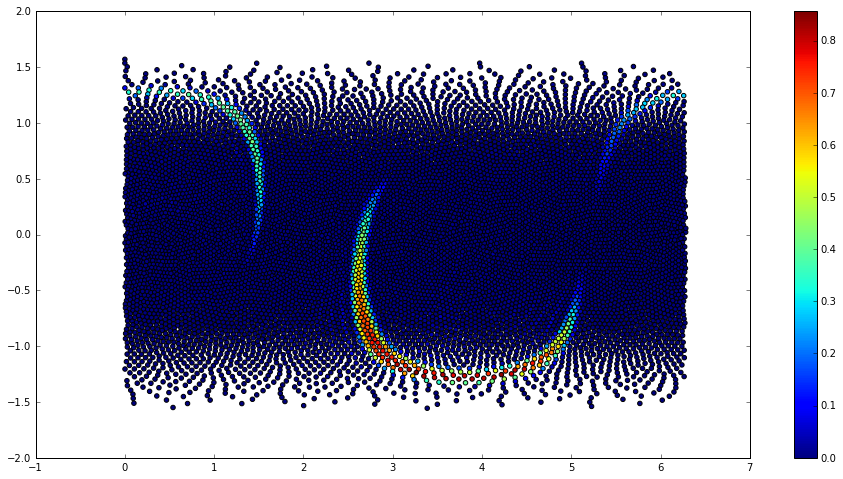

Finished time step 190 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 191 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 192 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 193 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 194 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 195 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 196 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 197 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 198 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 199 of 576 total -> 1.97e+01 seconds/timestep


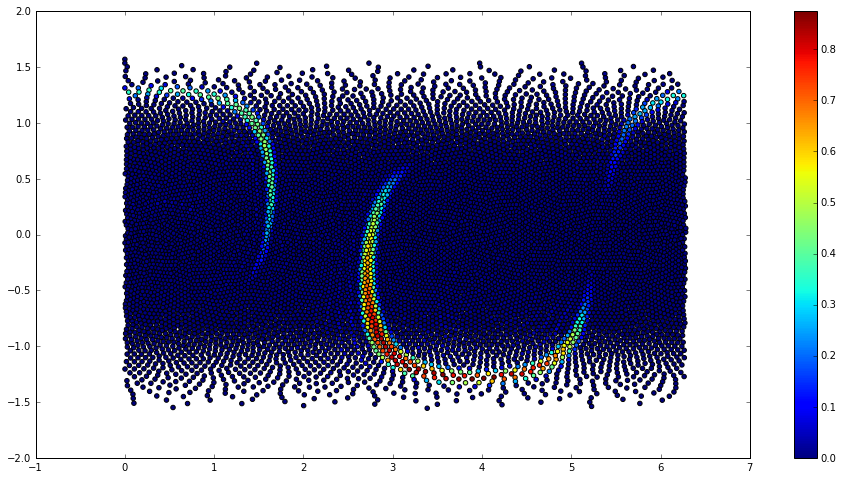

Finished time step 200 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 201 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 202 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 203 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 204 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 205 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 206 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 207 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 208 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 209 of 576 total -> 1.96e+01 seconds/timestep


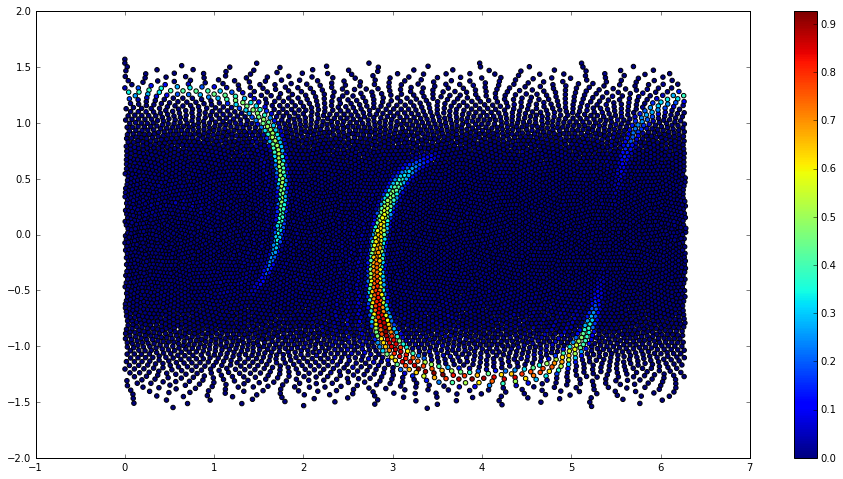

Finished time step 210 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 211 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 212 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 213 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 214 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 215 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 216 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 217 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 218 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 219 of 576 total -> 1.96e+01 seconds/timestep


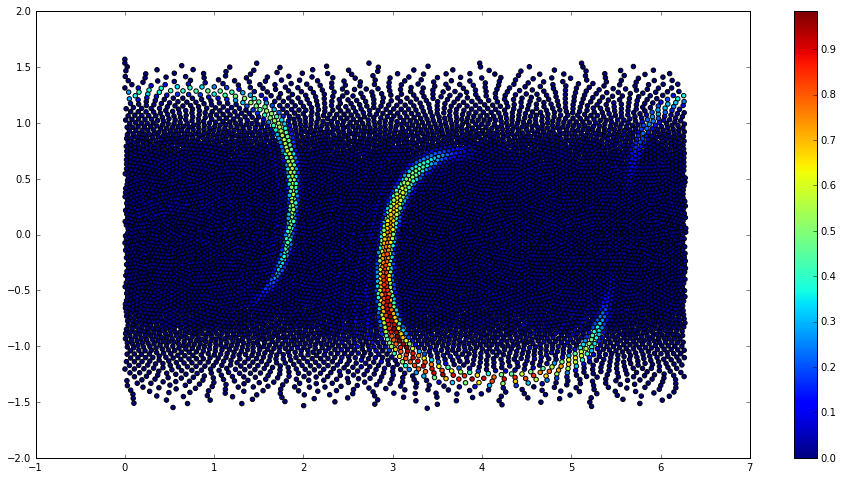

Finished time step 220 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 221 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 222 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 223 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 224 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 225 of 576 total -> 2.03e+01 seconds/timestep
Finished time step 226 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 227 of 576 total -> 2.19e+01 seconds/timestep
Finished time step 228 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 229 of 576 total -> 1.96e+01 seconds/timestep


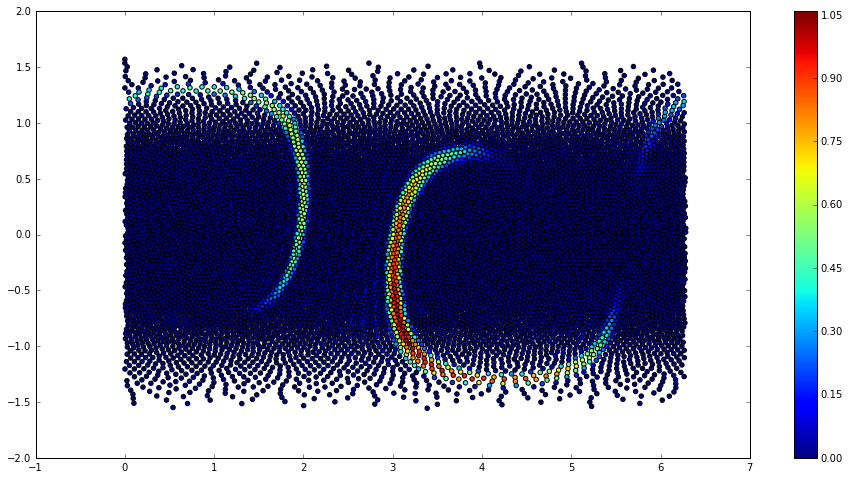

Finished time step 230 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 231 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 232 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 233 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 234 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 235 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 236 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 237 of 576 total -> 2.15e+01 seconds/timestep
Finished time step 238 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 239 of 576 total -> 1.98e+01 seconds/timestep


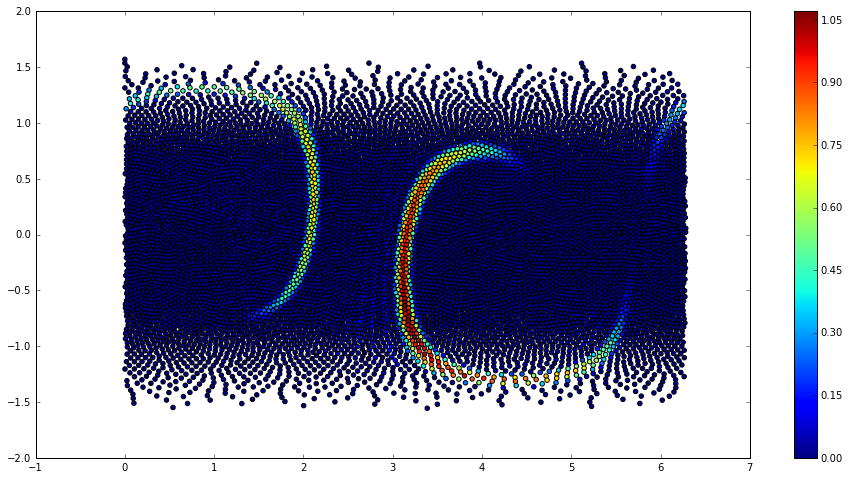

Finished time step 240 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 241 of 576 total -> 2.26e+01 seconds/timestep
Finished time step 242 of 576 total -> 2.11e+01 seconds/timestep
Finished time step 243 of 576 total -> 2.38e+01 seconds/timestep
Finished time step 244 of 576 total -> 2.33e+01 seconds/timestep
Finished time step 245 of 576 total -> 2.35e+01 seconds/timestep
Finished time step 246 of 576 total -> 2.28e+01 seconds/timestep
Finished time step 247 of 576 total -> 2.19e+01 seconds/timestep
Finished time step 248 of 576 total -> 2.33e+01 seconds/timestep
Finished time step 249 of 576 total -> 2.32e+01 seconds/timestep


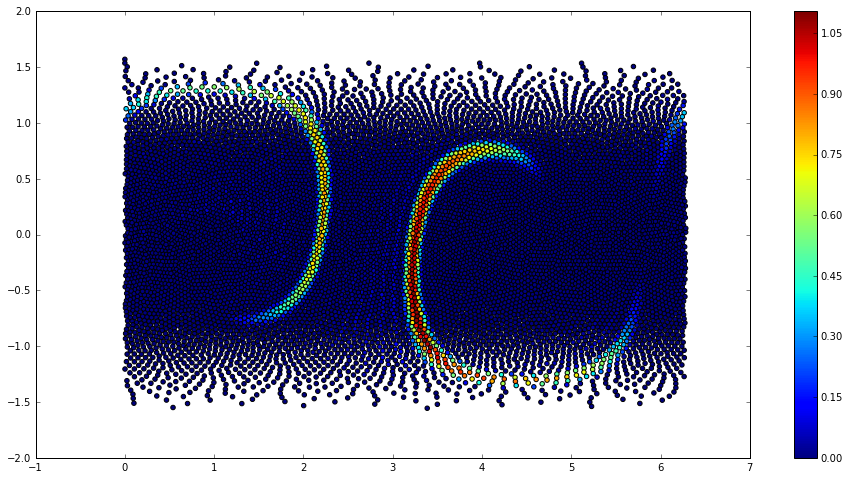

Finished time step 250 of 576 total -> 2.45e+01 seconds/timestep
Finished time step 251 of 576 total -> 2.39e+01 seconds/timestep
Finished time step 252 of 576 total -> 2.46e+01 seconds/timestep
Finished time step 253 of 576 total -> 2.43e+01 seconds/timestep
Finished time step 254 of 576 total -> 2.43e+01 seconds/timestep
Finished time step 255 of 576 total -> 2.31e+01 seconds/timestep
Finished time step 256 of 576 total -> 2.04e+01 seconds/timestep
Finished time step 257 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 258 of 576 total -> 2.08e+01 seconds/timestep
Finished time step 259 of 576 total -> 1.98e+01 seconds/timestep


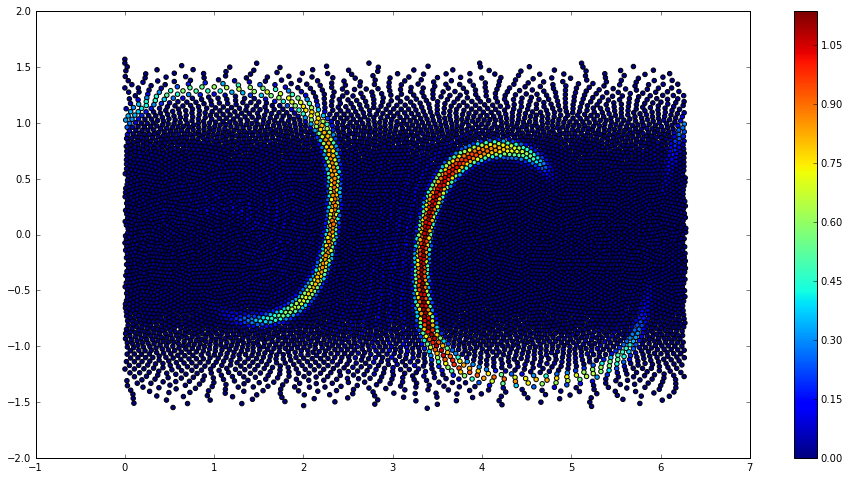

Finished time step 260 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 261 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 262 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 263 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 264 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 265 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 266 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 267 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 268 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 269 of 576 total -> 1.98e+01 seconds/timestep


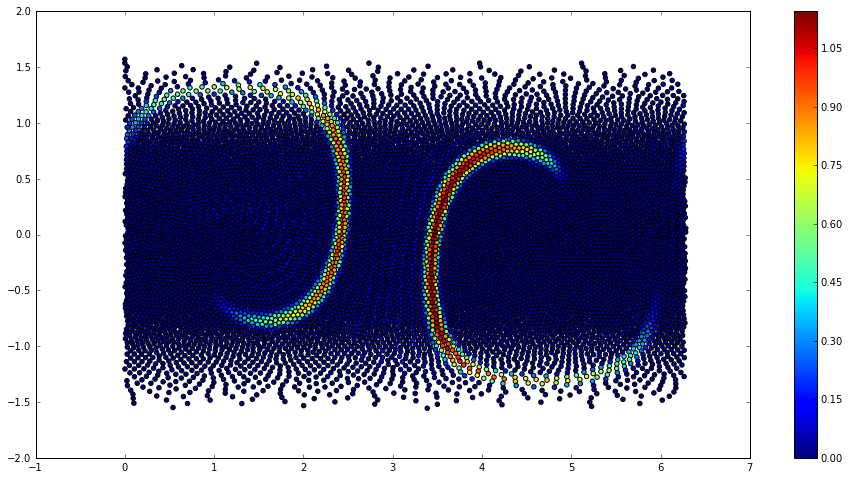

Finished time step 270 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 271 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 272 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 273 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 274 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 275 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 276 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 277 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 278 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 279 of 576 total -> 1.95e+01 seconds/timestep


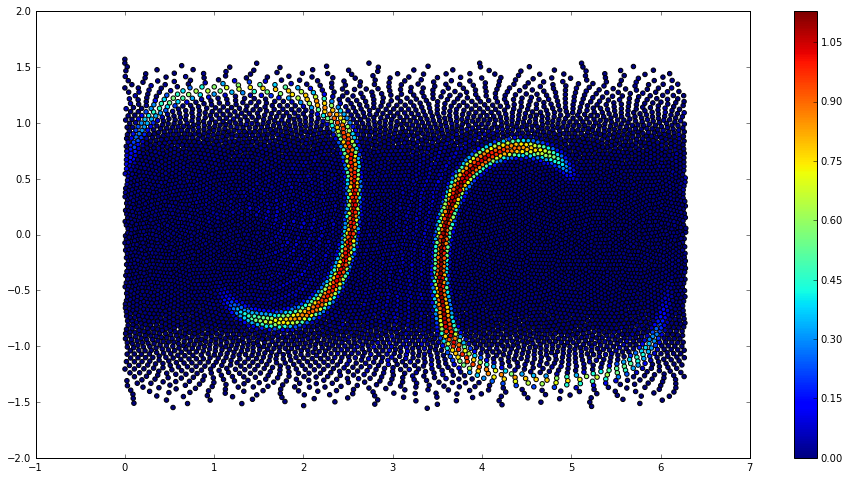

Finished time step 280 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 281 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 282 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 283 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 284 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 285 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 286 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 287 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 288 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 289 of 576 total -> 1.98e+01 seconds/timestep


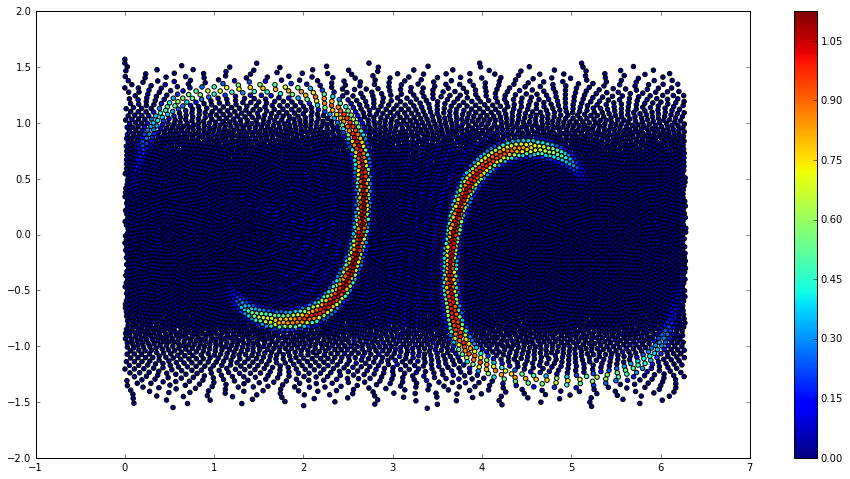

Finished time step 290 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 291 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 292 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 293 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 294 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 295 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 296 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 297 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 298 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 299 of 576 total -> 1.98e+01 seconds/timestep


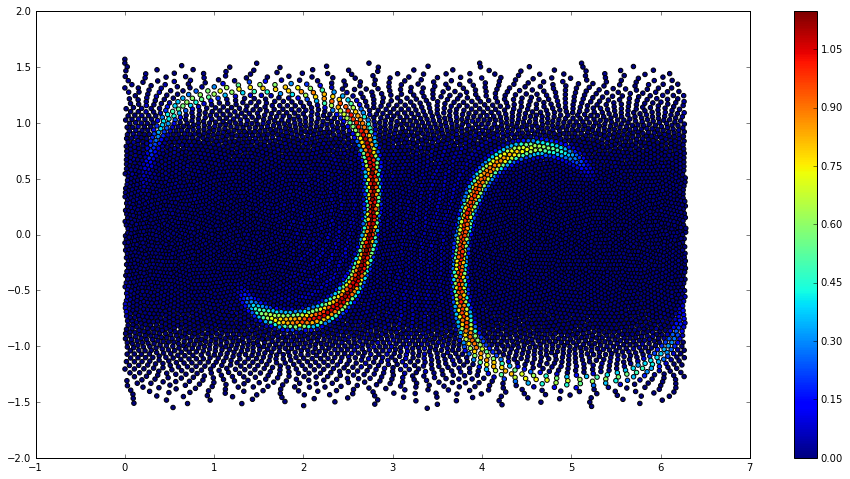

Finished time step 300 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 301 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 302 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 303 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 304 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 305 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 306 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 307 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 308 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 309 of 576 total -> 1.97e+01 seconds/timestep


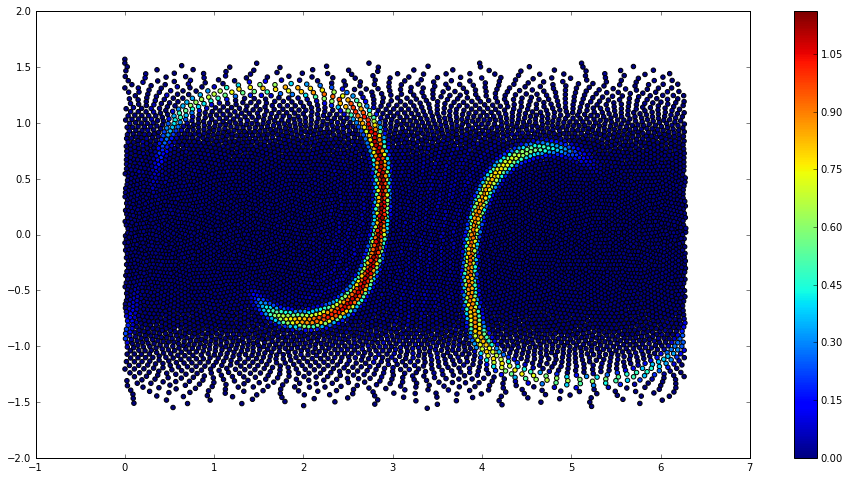

Finished time step 310 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 311 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 312 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 313 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 314 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 315 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 316 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 317 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 318 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 319 of 576 total -> 1.96e+01 seconds/timestep


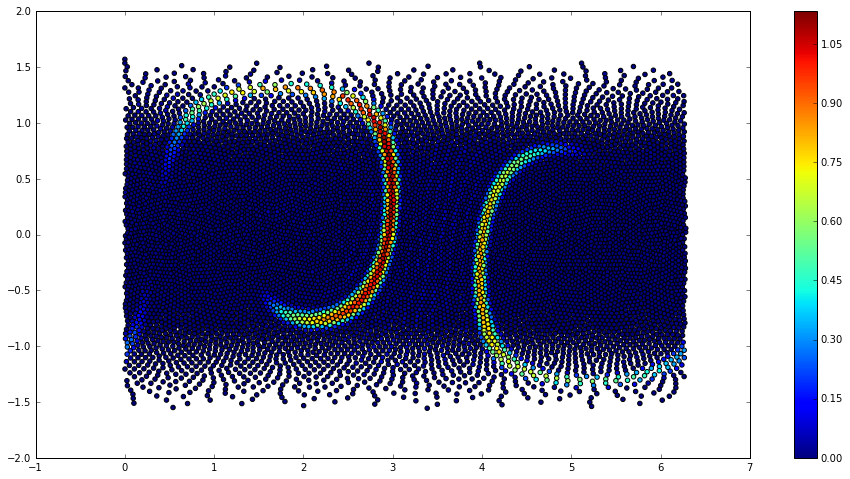

Finished time step 320 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 321 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 322 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 323 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 324 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 325 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 326 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 327 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 328 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 329 of 576 total -> 1.98e+01 seconds/timestep


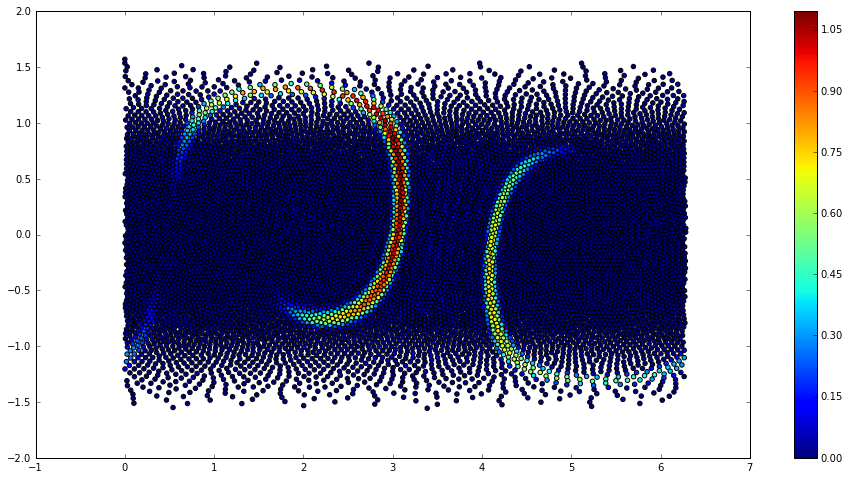

Finished time step 330 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 331 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 332 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 333 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 334 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 335 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 336 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 337 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 338 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 339 of 576 total -> 1.96e+01 seconds/timestep


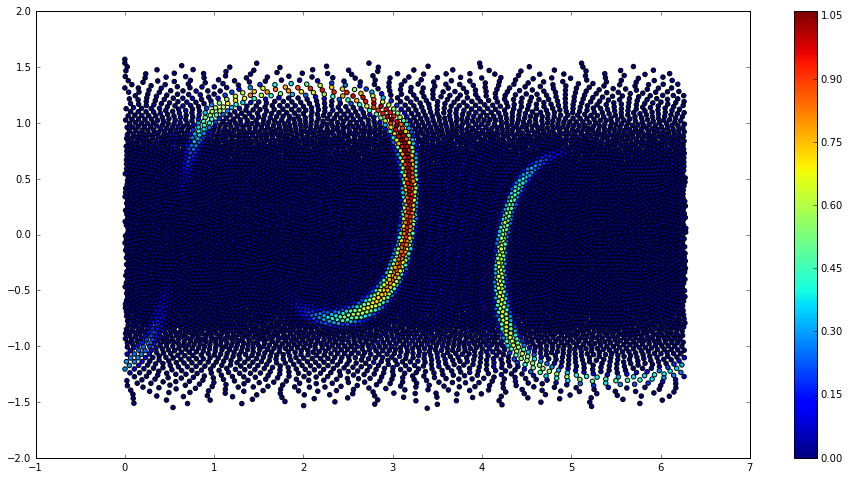

Finished time step 340 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 341 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 342 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 343 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 344 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 345 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 346 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 347 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 348 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 349 of 576 total -> 1.97e+01 seconds/timestep


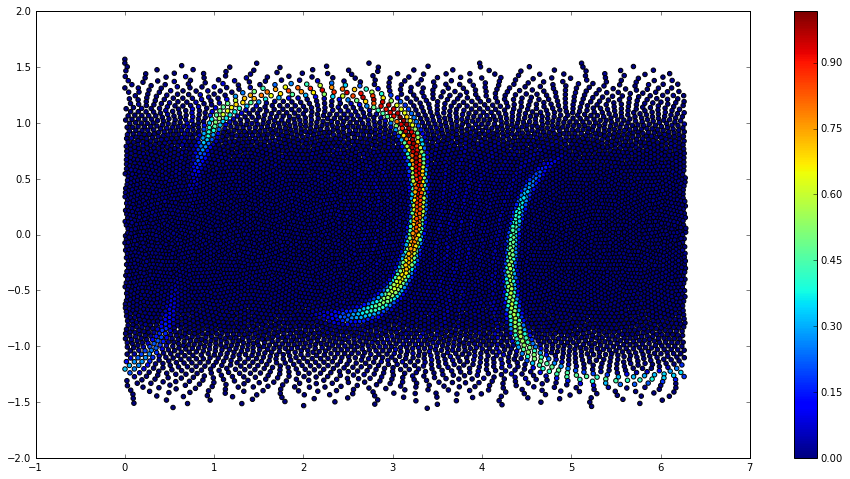

Finished time step 350 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 351 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 352 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 353 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 354 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 355 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 356 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 357 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 358 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 359 of 576 total -> 1.98e+01 seconds/timestep


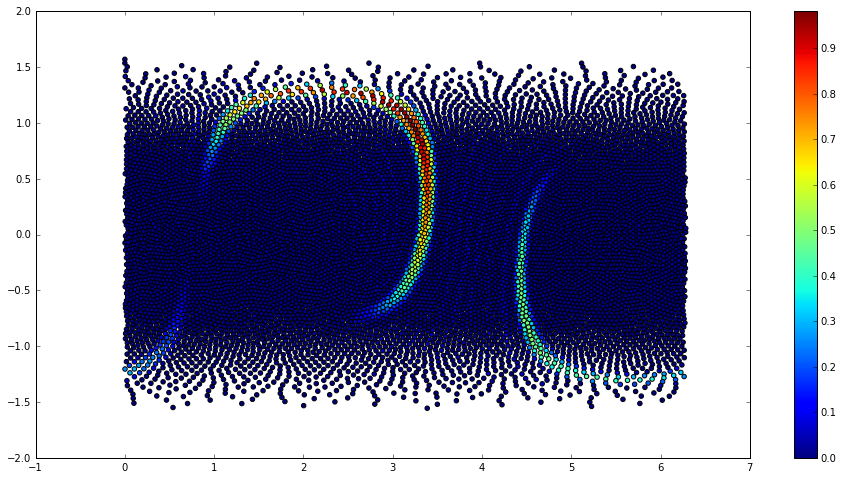

Finished time step 360 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 361 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 362 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 363 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 364 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 365 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 366 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 367 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 368 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 369 of 576 total -> 1.97e+01 seconds/timestep


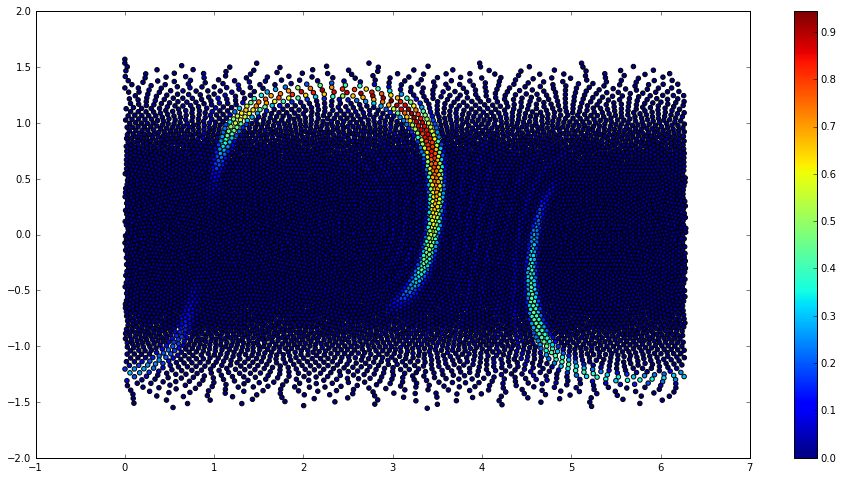

Finished time step 370 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 371 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 372 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 373 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 374 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 375 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 376 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 377 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 378 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 379 of 576 total -> 1.97e+01 seconds/timestep


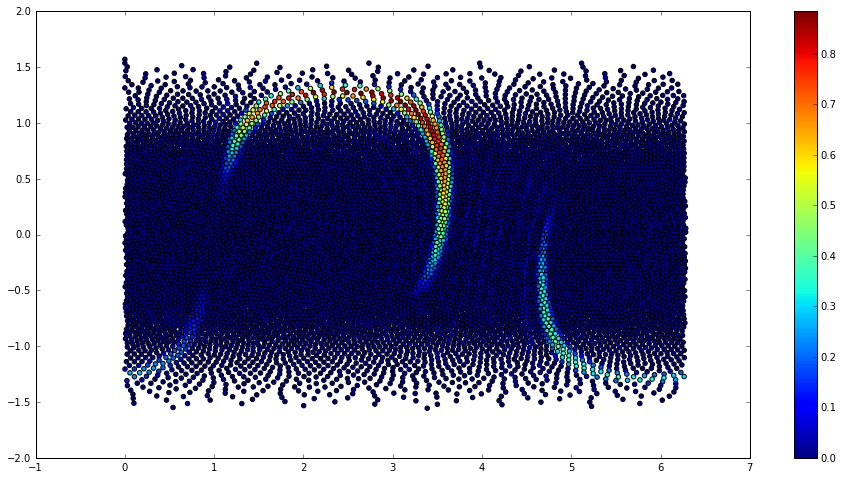

Finished time step 380 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 381 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 382 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 383 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 384 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 385 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 386 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 387 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 388 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 389 of 576 total -> 1.97e+01 seconds/timestep


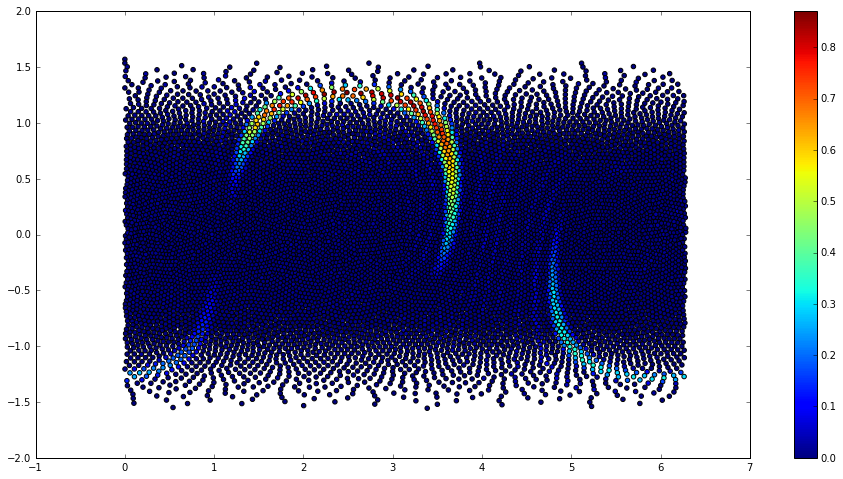

Finished time step 390 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 391 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 392 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 393 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 394 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 395 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 396 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 397 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 398 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 399 of 576 total -> 1.98e+01 seconds/timestep


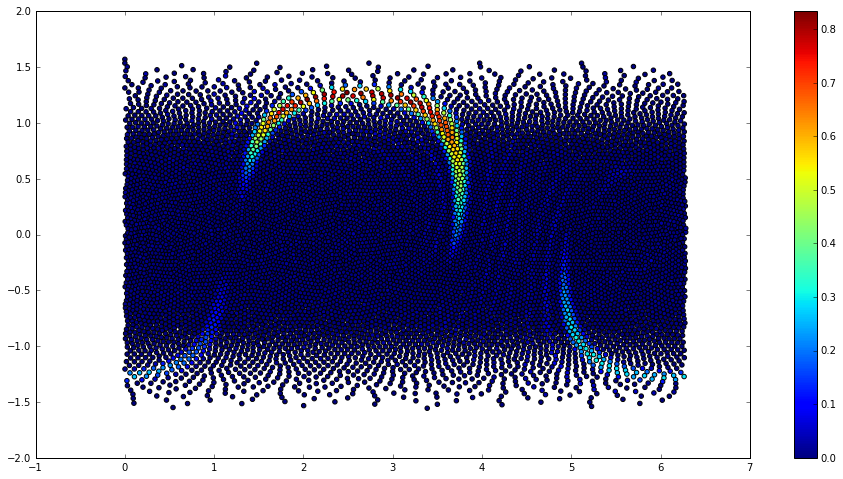

Finished time step 400 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 401 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 402 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 403 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 404 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 405 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 406 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 407 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 408 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 409 of 576 total -> 1.97e+01 seconds/timestep


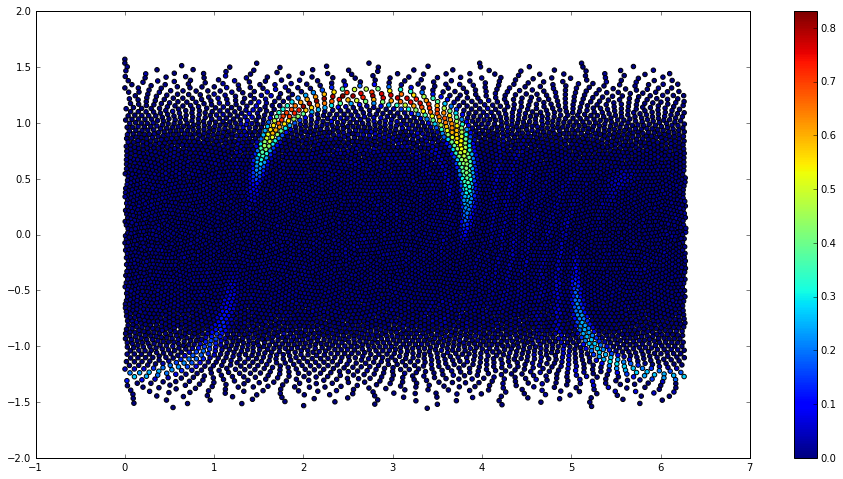

Finished time step 410 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 411 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 412 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 413 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 414 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 415 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 416 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 417 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 418 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 419 of 576 total -> 1.97e+01 seconds/timestep


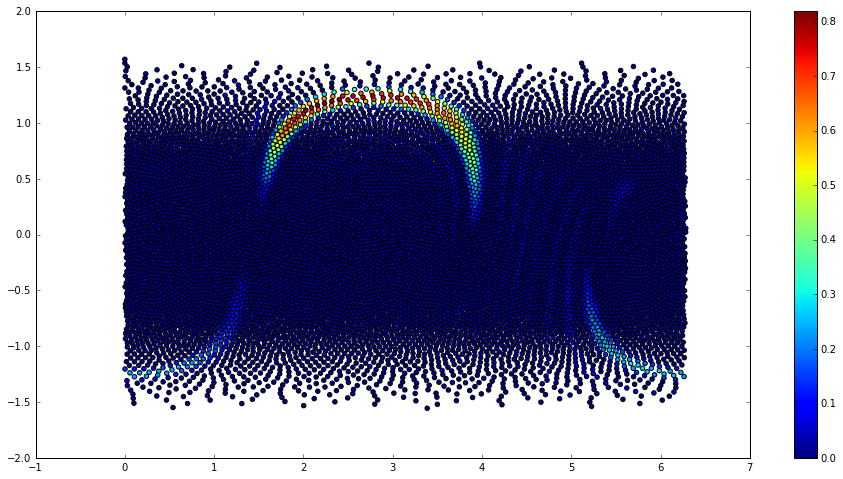

Finished time step 420 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 421 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 422 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 423 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 424 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 425 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 426 of 576 total -> 2.03e+01 seconds/timestep
Finished time step 427 of 576 total -> 2.07e+01 seconds/timestep
Finished time step 428 of 576 total -> 2.22e+01 seconds/timestep
Finished time step 429 of 576 total -> 2.29e+01 seconds/timestep


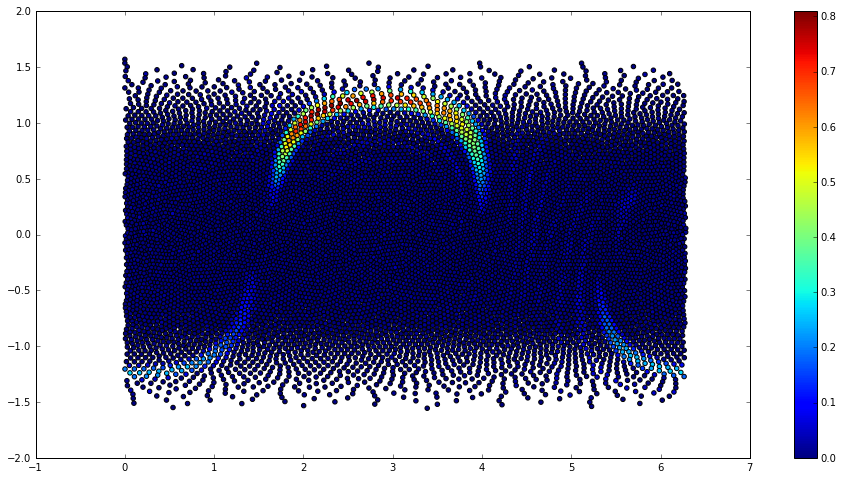

Finished time step 430 of 576 total -> 2.40e+01 seconds/timestep
Finished time step 431 of 576 total -> 2.20e+01 seconds/timestep
Finished time step 432 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 433 of 576 total -> 2.15e+01 seconds/timestep
Finished time step 434 of 576 total -> 2.18e+01 seconds/timestep
Finished time step 435 of 576 total -> 2.37e+01 seconds/timestep
Finished time step 436 of 576 total -> 2.13e+01 seconds/timestep
Finished time step 437 of 576 total -> 2.37e+01 seconds/timestep
Finished time step 438 of 576 total -> 2.29e+01 seconds/timestep
Finished time step 439 of 576 total -> 2.39e+01 seconds/timestep


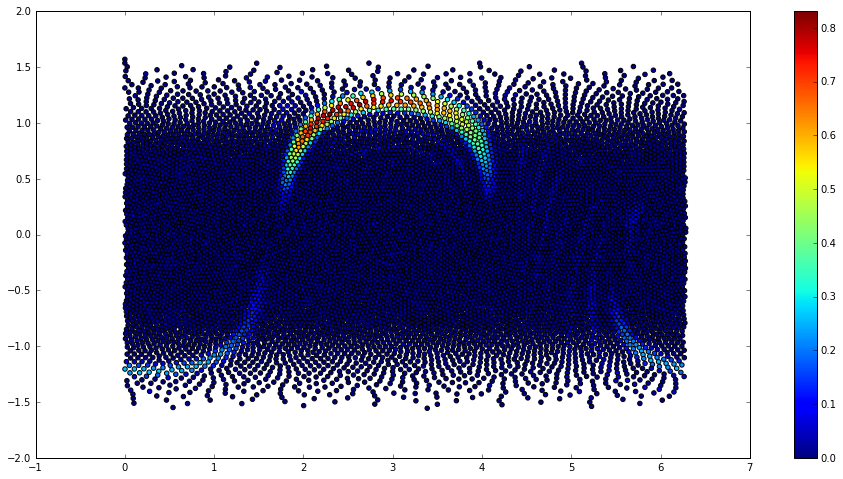

Finished time step 440 of 576 total -> 2.30e+01 seconds/timestep
Finished time step 441 of 576 total -> 2.29e+01 seconds/timestep
Finished time step 442 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 443 of 576 total -> 2.35e+01 seconds/timestep
Finished time step 444 of 576 total -> 2.35e+01 seconds/timestep
Finished time step 445 of 576 total -> 2.44e+01 seconds/timestep
Finished time step 446 of 576 total -> 2.29e+01 seconds/timestep
Finished time step 447 of 576 total -> 2.04e+01 seconds/timestep
Finished time step 448 of 576 total -> 2.09e+01 seconds/timestep
Finished time step 449 of 576 total -> 2.40e+01 seconds/timestep


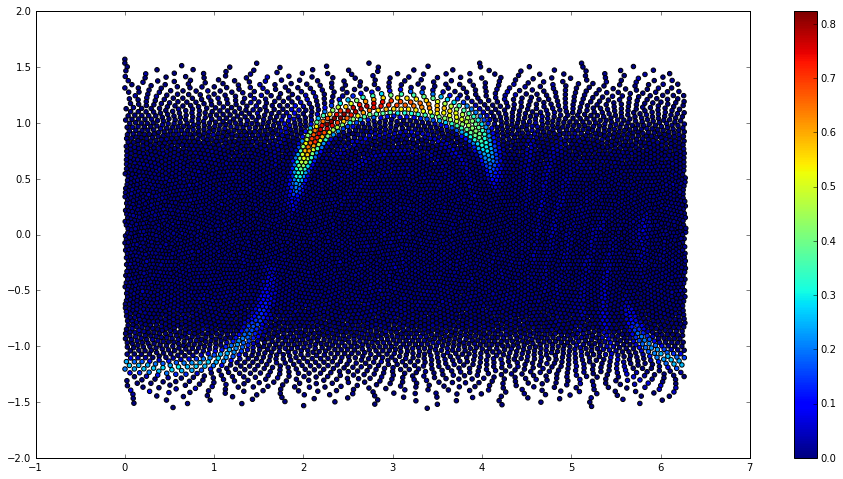

Finished time step 450 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 451 of 576 total -> 2.31e+01 seconds/timestep
Finished time step 452 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 453 of 576 total -> 2.31e+01 seconds/timestep
Finished time step 454 of 576 total -> 2.20e+01 seconds/timestep
Finished time step 455 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 456 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 457 of 576 total -> 2.28e+01 seconds/timestep
Finished time step 458 of 576 total -> 2.37e+01 seconds/timestep
Finished time step 459 of 576 total -> 2.27e+01 seconds/timestep


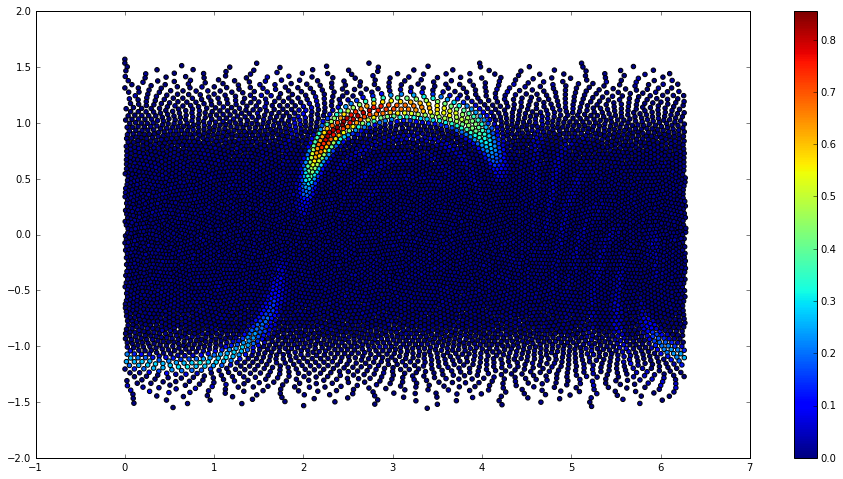

Finished time step 460 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 461 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 462 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 463 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 464 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 465 of 576 total -> 2.13e+01 seconds/timestep
Finished time step 466 of 576 total -> 2.43e+01 seconds/timestep
Finished time step 467 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 468 of 576 total -> 2.08e+01 seconds/timestep
Finished time step 469 of 576 total -> 2.17e+01 seconds/timestep


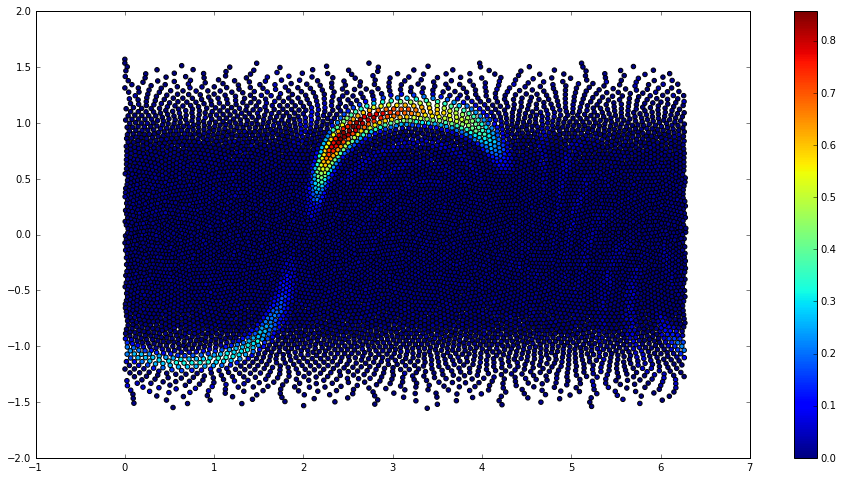

Finished time step 470 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 471 of 576 total -> 2.15e+01 seconds/timestep
Finished time step 472 of 576 total -> 2.26e+01 seconds/timestep
Finished time step 473 of 576 total -> 2.22e+01 seconds/timestep
Finished time step 474 of 576 total -> 2.22e+01 seconds/timestep
Finished time step 475 of 576 total -> 2.32e+01 seconds/timestep
Finished time step 476 of 576 total -> 2.32e+01 seconds/timestep
Finished time step 477 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 478 of 576 total -> 2.32e+01 seconds/timestep
Finished time step 479 of 576 total -> 2.27e+01 seconds/timestep


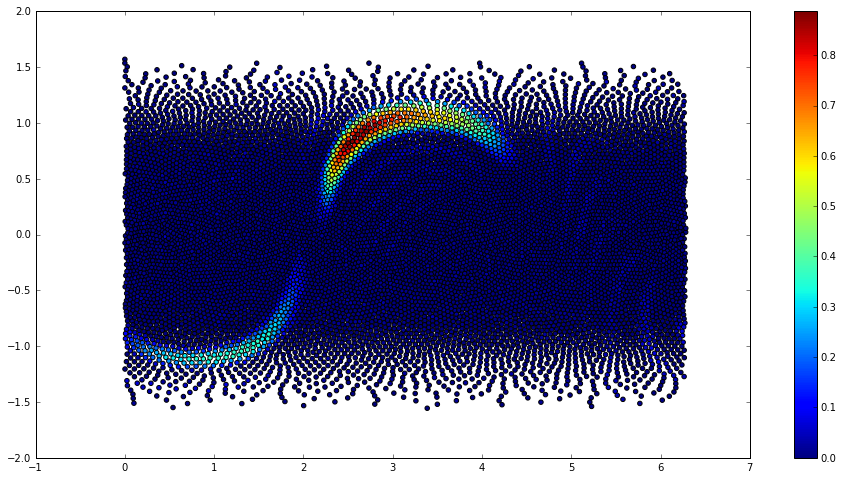

Finished time step 480 of 576 total -> 2.26e+01 seconds/timestep
Finished time step 481 of 576 total -> 2.41e+01 seconds/timestep
Finished time step 482 of 576 total -> 2.33e+01 seconds/timestep
Finished time step 483 of 576 total -> 2.25e+01 seconds/timestep
Finished time step 484 of 576 total -> 2.30e+01 seconds/timestep
Finished time step 485 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 486 of 576 total -> 2.18e+01 seconds/timestep
Finished time step 487 of 576 total -> 2.39e+01 seconds/timestep
Finished time step 488 of 576 total -> 2.25e+01 seconds/timestep
Finished time step 489 of 576 total -> 2.36e+01 seconds/timestep


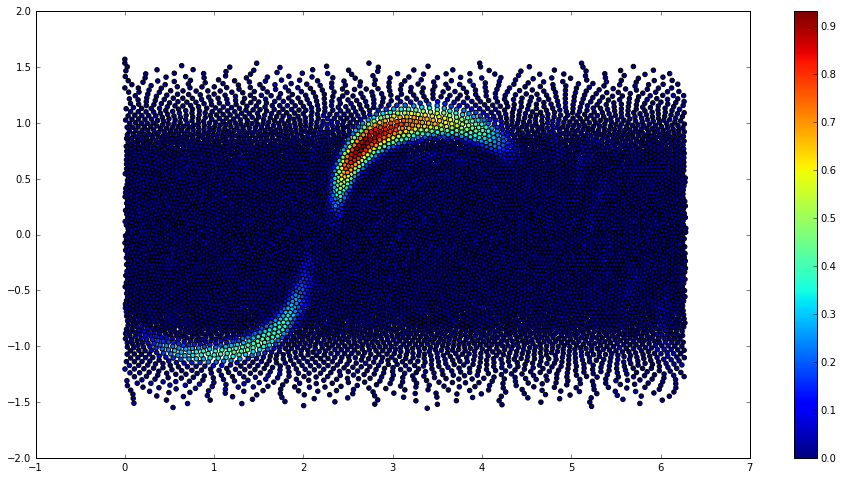

Finished time step 490 of 576 total -> 2.43e+01 seconds/timestep
Finished time step 491 of 576 total -> 2.45e+01 seconds/timestep
Finished time step 492 of 576 total -> 2.45e+01 seconds/timestep
Finished time step 493 of 576 total -> 2.17e+01 seconds/timestep
Finished time step 494 of 576 total -> 2.36e+01 seconds/timestep
Finished time step 495 of 576 total -> 2.39e+01 seconds/timestep
Finished time step 496 of 576 total -> 2.31e+01 seconds/timestep
Finished time step 497 of 576 total -> 2.35e+01 seconds/timestep
Finished time step 498 of 576 total -> 2.34e+01 seconds/timestep
Finished time step 499 of 576 total -> 2.31e+01 seconds/timestep


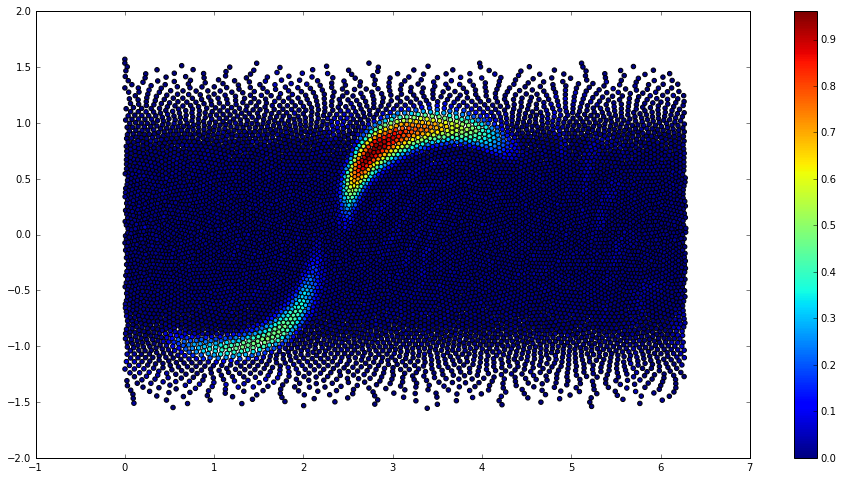

Finished time step 500 of 576 total -> 2.30e+01 seconds/timestep
Finished time step 501 of 576 total -> 2.31e+01 seconds/timestep
Finished time step 502 of 576 total -> 2.34e+01 seconds/timestep
Finished time step 503 of 576 total -> 2.36e+01 seconds/timestep
Finished time step 504 of 576 total -> 2.43e+01 seconds/timestep
Finished time step 505 of 576 total -> 2.20e+01 seconds/timestep
Finished time step 506 of 576 total -> 2.15e+01 seconds/timestep
Finished time step 507 of 576 total -> 2.06e+01 seconds/timestep
Finished time step 508 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 509 of 576 total -> 2.21e+01 seconds/timestep


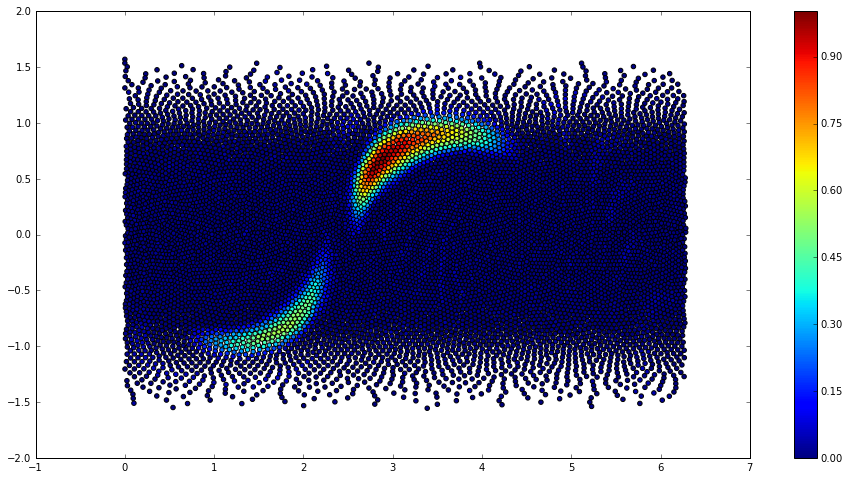

Finished time step 510 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 511 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 512 of 576 total -> 2.34e+01 seconds/timestep
Finished time step 513 of 576 total -> 2.23e+01 seconds/timestep
Finished time step 514 of 576 total -> 2.30e+01 seconds/timestep
Finished time step 515 of 576 total -> 2.45e+01 seconds/timestep
Finished time step 516 of 576 total -> 2.39e+01 seconds/timestep
Finished time step 517 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 518 of 576 total -> 2.12e+01 seconds/timestep
Finished time step 519 of 576 total -> 2.33e+01 seconds/timestep


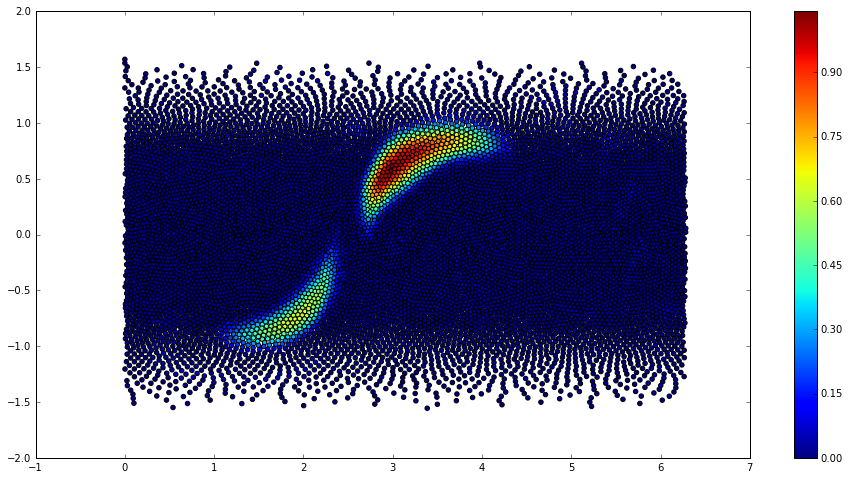

Finished time step 520 of 576 total -> 2.06e+01 seconds/timestep
Finished time step 521 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 522 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 523 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 524 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 525 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 526 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 527 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 528 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 529 of 576 total -> 1.98e+01 seconds/timestep


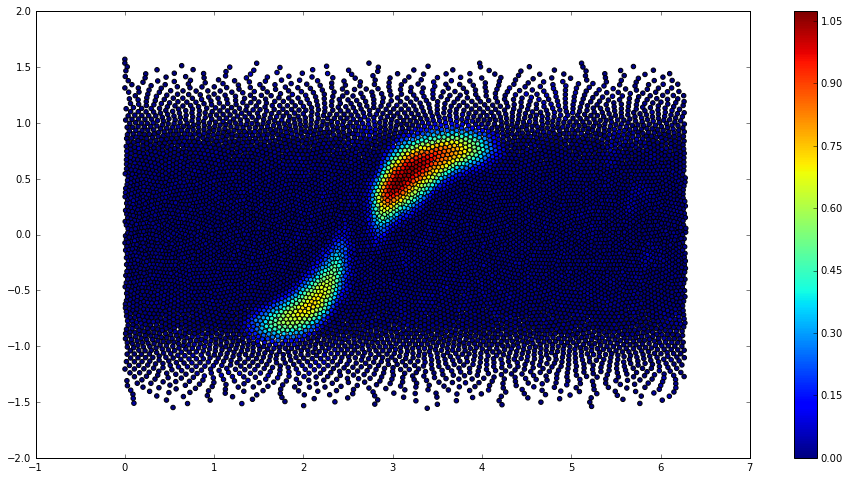

Finished time step 530 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 531 of 576 total -> 1.98e+01 seconds/timestep
Finished time step 532 of 576 total -> 2.16e+01 seconds/timestep
Finished time step 533 of 576 total -> 2.21e+01 seconds/timestep
Finished time step 534 of 576 total -> 2.39e+01 seconds/timestep
Finished time step 535 of 576 total -> 2.11e+01 seconds/timestep
Finished time step 536 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 537 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 538 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 539 of 576 total -> 1.98e+01 seconds/timestep


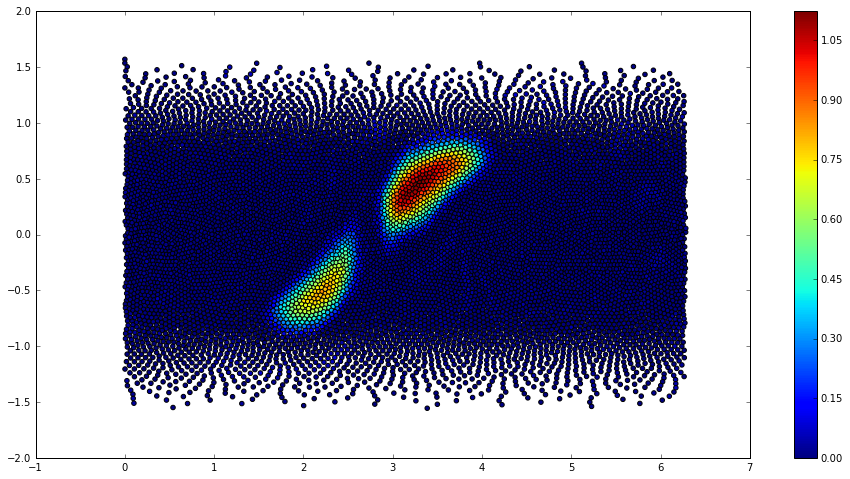

Finished time step 540 of 576 total -> 1.99e+01 seconds/timestep
Finished time step 541 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 542 of 576 total -> 2.02e+01 seconds/timestep
Finished time step 543 of 576 total -> 2.02e+01 seconds/timestep
Finished time step 544 of 576 total -> 2.17e+01 seconds/timestep
Finished time step 545 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 546 of 576 total -> 2.07e+01 seconds/timestep
Finished time step 547 of 576 total -> 2.18e+01 seconds/timestep
Finished time step 548 of 576 total -> 2.34e+01 seconds/timestep
Finished time step 549 of 576 total -> 2.09e+01 seconds/timestep


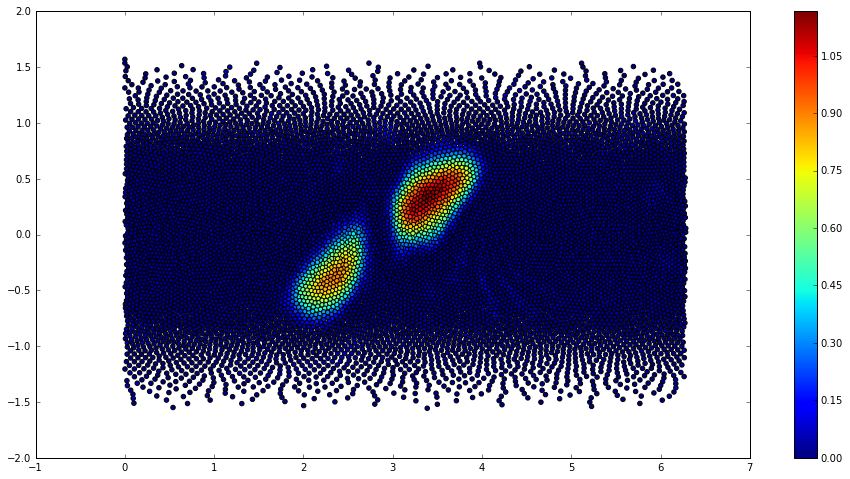

Finished time step 550 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 551 of 576 total -> 2.25e+01 seconds/timestep
Finished time step 552 of 576 total -> 2.36e+01 seconds/timestep
Finished time step 553 of 576 total -> 2.07e+01 seconds/timestep
Finished time step 554 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 555 of 576 total -> 1.97e+01 seconds/timestep
Finished time step 556 of 576 total -> 2.00e+01 seconds/timestep
Finished time step 557 of 576 total -> 2.12e+01 seconds/timestep
Finished time step 558 of 576 total -> 2.33e+01 seconds/timestep
Finished time step 559 of 576 total -> 2.40e+01 seconds/timestep


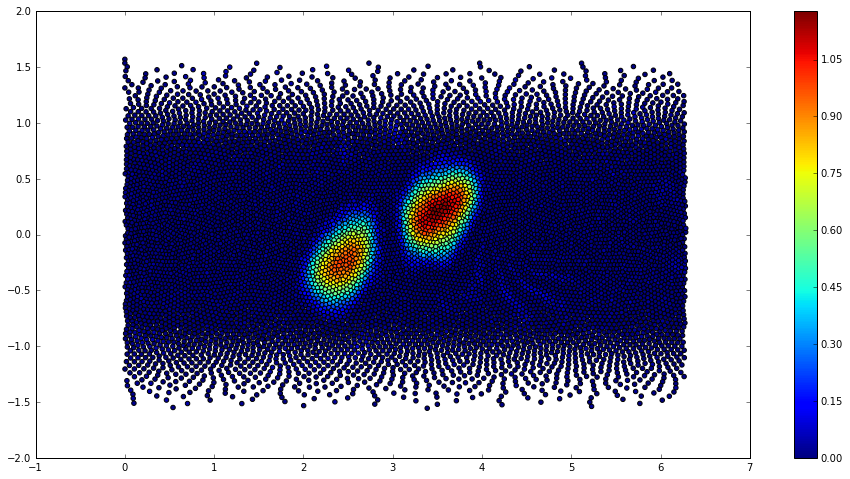

Finished time step 560 of 576 total -> 2.24e+01 seconds/timestep
Finished time step 561 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 562 of 576 total -> 2.14e+01 seconds/timestep
Finished time step 563 of 576 total -> 2.38e+01 seconds/timestep
Finished time step 564 of 576 total -> 2.27e+01 seconds/timestep
Finished time step 565 of 576 total -> 2.47e+01 seconds/timestep
Finished time step 566 of 576 total -> 2.30e+01 seconds/timestep
Finished time step 567 of 576 total -> 2.17e+01 seconds/timestep
Finished time step 568 of 576 total -> 2.16e+01 seconds/timestep
Finished time step 569 of 576 total -> 1.99e+01 seconds/timestep


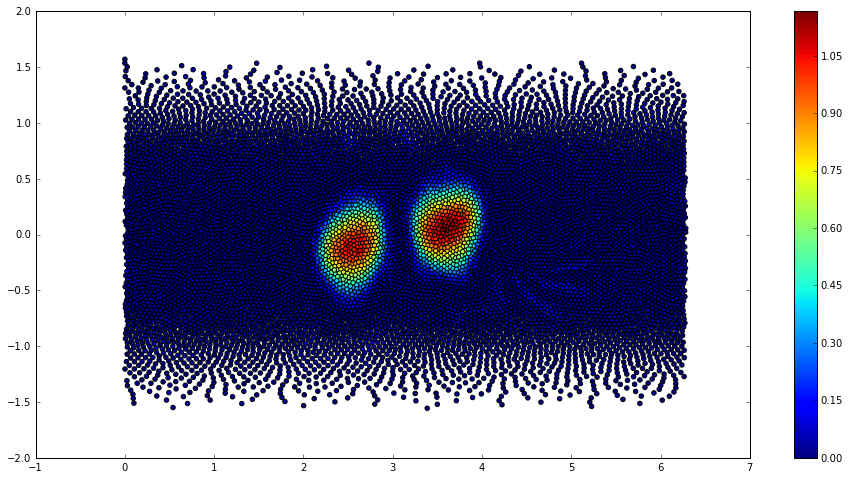

Finished time step 570 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 571 of 576 total -> 1.96e+01 seconds/timestep
Finished time step 572 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 573 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 574 of 576 total -> 1.95e+01 seconds/timestep
Finished time step 575 of 576 total -> 1.97e+01 seconds/timestep


In [15]:
delta_t = 1800
nsteps = int(np.floor(tau/delta_t))

hist_int = 1
plot_int = 10

q_0 = set_ghosts(q1(r,lmbda,phi))

q_t = np.empty(q_0.shape)
q_temp = np.empty(q_0.shape)
q_t[:] = q_0[:]
q_temp[:] = q_0[:]

plt.ion()

t_total = 0.0

for tstep in range(nsteps):
    
    start = time.time()
    
    # RK4 step 1
    t = tstep*delta_t
    U = u_t(r,lmbda,phi,t)[:,:,depth:Nv+depth]
    RHS = eval_RHS(q_t,U,FDVs,DMs,idx)
    d = RHS
    
    # RK4 step 2
    t += delta_t/2
    U = u_t(r,lmbda,phi,t)[:,:,depth:Nv+depth]
    q_temp[:,depth:Nv+depth] = q_t[:,depth:Nv+depth] + (delta_t/2)*RHS
    RHS = eval_RHS(q_temp,U,FDVs,DMs,idx)
    d += 2*RHS
    
    # RK4 step 3
    q_temp[:,depth:Nv+depth] = q_t[:,depth:Nv+depth] + (delta_t/2)*RHS
    RHS = eval_RHS(q_temp,U,FDVs,DMs,idx)
    d += 2*RHS
    
    # RK4 step 4
    t += delta_t/2
    U = u_t(r,lmbda,phi,t)[:,:,depth:Nv+depth]
    q_temp[:,depth:Nv+depth] = q_t[:,depth:Nv+depth] + delta_t*RHS
    RHS = eval_RHS(q_temp,U,FDVs,DMs,idx)
    d += RHS
    
    # Update tracers
    q_t[:,depth:Nv+depth] += (delta_t/6)*d
    
    t_total = time.time() - start
    
    if (tstep+1)%hist_int == 0 or tstep == 0:
        
        print("Finished time step",tstep,"of",nsteps,"total -> {0:<.2e} seconds/timestep".format(t_total))
        
    if (tstep+1)%plot_int == 0 or tstep == 0:
              
        pltlvl = int(np.floor(Nv*(Z_c/htop))+depth-1)
        fig = plt.figure(figsize=(16,8))
        ax = fig.add_subplot(1,1,1)
        cax = ax.scatter(lmbda[:,0],phi[:,0],c = q_t[:,pltlvl],vmin=0.0)
        cbar = fig.colorbar(cax)
        plt.show()



In [1]:
### Solution Error Norms
l1 = np.sum(np.abs(q_0 - q_t)) / np.sum(np.abs(q_0))
l2 = np.sqrt(np.sum((q_0 - q_t)**2) / np.sum(q_0**2))
linf = np.max(np.abs(q_0 - q_t)) / np.max(np.abs(q_0))

### Mass Conservation
rho_0 = rho(r)
V = (4*pi*r**2)*h/Nh
Mt_tot = np.sum(rho_0*V*q_t)
M0_tot = np.sum(rho_0*V*q_0)

### Print Error Results
print("Solution Extrema:\n\tMin:  \t{0:.2e}".format(np.min(q_t)),"\n\tMax:  \t{0:.2e}".format(np.max(q_t)))
print("Error Results:","\n\tL_1:  \t{0:.2e}".format(l1),"\n\tL_2:  \t{0:.2e}".format(l2),"\n\tL_inf:\t{0:.2e}".format(linf))
print("\nTracer Mass Difference:\t%{0:.3f}".format(np.abs(100*(Mt_tot-M0_tot)/M0_tot)))

### Plot Final Solution
pltlvl = int(np.floor(Nv*(Z_c/htop))+depth)
fig = plt.figure(figsize=(16,8))
ax = fig.add_subplot(1,1,1)
cax = ax.scatter(lmbda[:,0],phi[:,0],c = q_t[:,pltlvl],vmin=0.0)
cbar = fig.colorbar(cax)

NameError: name 'np' is not defined

In [17]:
# Config: Nh = 4096, Nv = 24, n = 55, dt = 1440, 
# Error: L_1 = 3.492, L_2 = 0.530, L_inf = 0.499
# Timing: 6.75 s/timestep

# Config: Nh = 10000, Nv = 30, n = 55, dt = 1800, 
# Error: L_1 = 1.364, L_2 = 0.254, L_inf = 0.353
# Tracer Mass Difference: %0.457
# Timing: 19.5 s/timestep